In [5]:
from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)
import keras.backend as K



/home/jackalak/.local/lib/python3.6/site-packages/tensorflow/python/client/session.py:1751: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


## Some background reading

###### Space Weather:
- [Introduction](https://ccmc.gsfc.nasa.gov/RoR_WWW/SWREDI/2016/SpaceWeatherIntro_Bootcamp_2016.pdf)
- [Understanding space weather](https://www.sciencedirect.com/science/article/pii/S0273117715002252)

###### Particle Precipitation:
Here are a few particle precipitation resources that I believe are most valuable to start with:
- Technical details of the observations: [Redmon et al., [2017]](https://agupubs.onlinelibrary.wiley.com/doi/full/10.1002/2016JA023339)
- Creating particle precipitation models from these data: [Hardy et al., [1987]](https://doi.org/10.1029/JA090iA05p04229) and [Newell et al., [2009]](https://doi.org/10.1029/2009JA014326)
- Considered the 'state of the art' model: [OVATION PRIME](https://ccmc.gsfc.nasa.gov/models/modelinfo.php?model=Ovation%20Prime)



## Imports and utility functions


In [6]:
import numpy as np
import os
import pandas as pd
import seaborn as sns
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import datetime
from os.path import isfile, join
from sys import getsizeof
import glob

from random import *

from sklearn import *


from keras.models import Sequential, Model
from keras.layers import Dense, Conv1D, Flatten, Input, LSTM, TimeDistributed, MaxPooling1D
from keras.layers.merge import concatenate

import keras.backend as K



import sys
print(sys.maxsize)
np.set_printoptions(threshold=sys.maxsize*2)

9223372036854775807


In [7]:
def mean_errors_over_range(ytrue, ypred, nbins):
    low = min(ytrue)
    high = max(ytrue)
    bins = np.linspace(low, high, nbins)
    mean_error_and_num = np.zeros((nbins,2))
    error = ytrue-ypred
    for i in range(ypred.shape[0]):
        index = int((ytrue[i]-low)/(bins[1]-bins[0]))
        mean_error_and_num[index,1]=mean_error_and_num[index,1]+1
        mean_error_and_num[index,0]+=error[i]
    
    for index in range(0,nbins-1):
        mean_error_and_num[index,0]= mean_error_and_num[index,0]/mean_error_and_num[index,1]
                      
    plotsize=(10,10)
    plt.figure(figsize=plotsize)                                  
    plt.plot(error)   
    plt.title('error vs timestep')
    plt.figure(figsize=plotsize)          
    plt.plot(mean_error_and_num[:,0])
    plt.title('mean error vs bins')
    plt.figure(figsize=plotsize)                                  
    plt.plot(mean_error_and_num[:,1])
    plt.title('number vs bins')
    plt.figure(figsize=plotsize)                                  
    plt.scatter(bins, mean_error_and_num[:,0])
    plt.title('mean error vs bins')
    plt.figure(figsize=plotsize)                                  
    plt.scatter(bins, mean_error_and_num[:,1])
    plt.title('number vs bins')
    
    print('min', low, 'max', 'high', high, 'mean true', np.mean(ytrue), 'mean pred', 
          np.mean(ypred), 'median ytrue', np.median(ytrue))#,  'mode ytrue', np.mode(ytrue))

    
    return bins, mean_error_and_num

## Prepare data for ML exploration (read in full DB created from standard_ML_DB_preparation.ipynb)


In [8]:
file_load_df_cumulative = 'ML_DB_subsamp_ext_full_dfCumulative_complexHemisphereCombine.csv'
DMSP_DATA_DIR=''
df_cumulative = pd.read_csv(os.path.join(DMSP_DATA_DIR,file_load_df_cumulative))
df_cumulative = df_cumulative.sort_values(by=['ID_SC', 'Datetimes'])
df_cumulative = df_cumulative.set_index('Datetimes')
df_cumulative.index = pd.to_datetime(df_cumulative.index)
print(df_cumulative.columns )
cols_to_drop_validation = [c for c in df_cumulative.columns if ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]
# cols_to_drop_validation = [c for c in df.columns if ('1min' in c) | ('3min' in c) | ('4min' in c) | ('5min' in c) | ('15min' in c) | ('newell' in c) | ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]



Index(['SC_AACGM_LAT', 'SC_AACGM_LTIME', 'ELE_TOTAL_ENERGY_FLUX',
       'ELE_TOTAL_ENERGY_FLUX_STD', 'ELE_AVG_ENERGY', 'ELE_AVG_ENERGY_STD',
       'ID_SC', 'sin_ut', 'cos_ut', 'sin_doy',
       ...
       'AE_5min', 'AL_5min', 'AU_5min', 'SymH_5min', 'PC_5min', 'vsw_5min',
       'vx_5min', 'psw_5min', 'borovsky_5min', 'newell_5min'],
      dtype='object', length=153)


In [9]:
df_cumulative = df_cumulative.drop(columns=cols_to_drop_validation)



In [10]:
# Separate training and testing data
mask_val = [(df_cumulative.index.year == 2010) & (df_cumulative['ID_SC'].values==16)]
df_val = df_cumulative[mask_val[0]].copy(deep=True)
df_train = df_cumulative.copy(deep=True).drop( df_cumulative.index[mask_val[0]])
print('validation data shape = {}'.format(df_val.shape))
print('train data shape = {}'.format(df_train.shape))
print('NOTE: we will use CV on the train data below to define model training and testing data,\n  so have called the withheld data *validation* data here')

# Construct X and y
feature_cols = [c for c in df_cumulative.columns if not 'ELE' in c]
#print( (feature_cols))
#print(df_cumulative.columns)

X_val = df_val[feature_cols].copy(deep=True)
y_val = df_val['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train[feature_cols].copy(deep=True)
y_train = df_train['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
#print(numFeatures)

validation data shape = (55210, 149)
train data shape = (1838283, 149)
NOTE: we will use CV on the train data below to define model training and testing data,
  so have called the withheld data *validation* data here


In [11]:
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))

%matplotlib inline  
import matplotlib.pyplot as plt
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

Y = np.array(y_train_log, dtype=np.float32)
X.shape
X[:,2].size
Y.size

1838283

In [12]:
y_val_diff_log =    y_val_log[1:].values    -  y_val_log[0:y_val_log.shape[0]-1].values;
y_train_diff_log =    y_train_log[1:].values    -  y_train_log[0:y_train_log.shape[0]-1].values;
print(y_train_diff_log.shape)
y_train_log[0:y_train_log.shape[0]-1].shape


(1838282,)


(1838282,)

In [13]:

def custom_loss(y_true,y_pred):
        print(y_true.shape)
        return K.mean(K.sum(K.square(y_pred[:,0] - y_true[:,0])))   


In [14]:
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#compile model using accuracy to measure model performance
model.compile(loss=custom_loss, optimizer='adam', metrics=['mse'])
model.fit(X[1:,:], np.array(y_train_diff_log), validation_data=(X_test[1:,:], np.array(y_val_diff_log)), epochs=40)



(None, None)
Train on 1838282 samples, validate on 55209 samples
Epoch 1/40
1838282/1838282 [==============================] - 52s 28us/step - loss: 35.7812 - mse: 1.1182 - val_loss: 54.4904 - val_mse: 1.7030
Epoch 2/40
1838282/1838282 [==============================] - 53s 29us/step - loss: 35.7793 - mse: 1.1181 - val_loss: 54.4879 - val_mse: 1.7029
Epoch 3/40
1838282/1838282 [==============================] - 58s 32us/step - loss: 35.7796 - mse: 1.1181 - val_loss: 54.4885 - val_mse: 1.7029
Epoch 4/40
1838282/1838282 [==============================] - 58s 31us/step - loss: 35.7794 - mse: 1.1181 - val_loss: 54.4879 - val_mse: 1.7029
Epoch 5/40
1838282/1838282 [==============================] - 56s 31us/step - loss: 35.7799 - mse: 1.1181 - val_loss: 54.4902 - val_mse: 1.7029
Epoch 6/40
1838282/1838282 [==============================] - 58s 32us/step - loss: 35.7794 - mse: 1.1181 - val_loss: 54.4881 - val_mse: 1.7029
Epoch 7/40
1838282/1838282 [==============================] - 53s 29us/

KeyboardInterrupt: 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min -5.5106057843909335 max high 5.694439034682256 mean true 4.288177568638856e-06 mean pred 0.010856048 median ytrue 0.0


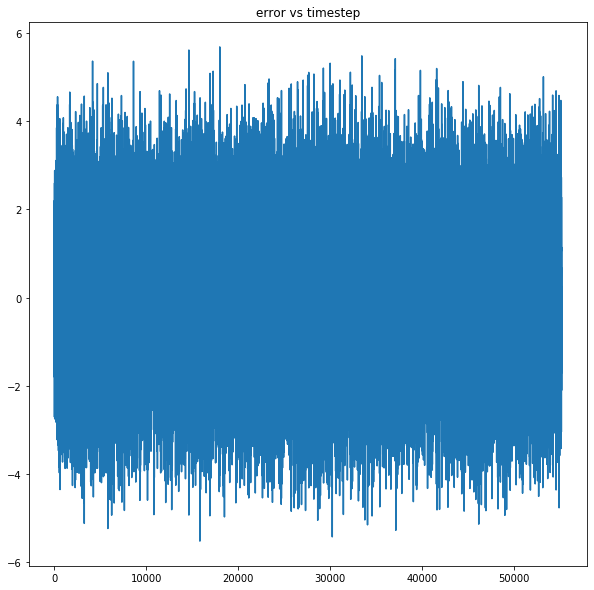

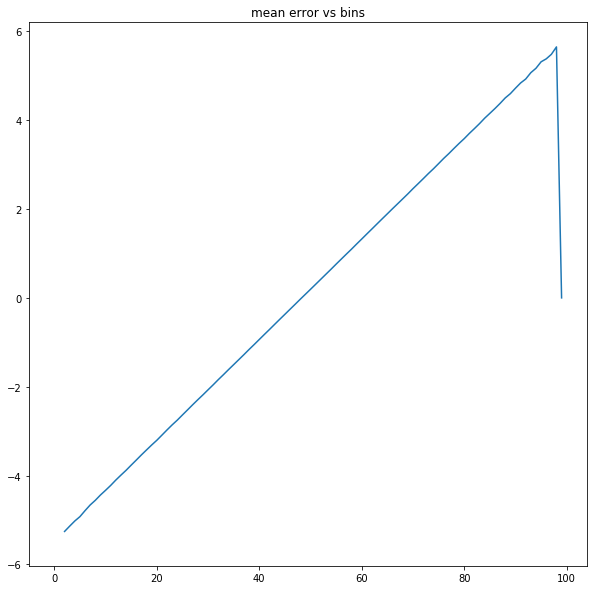

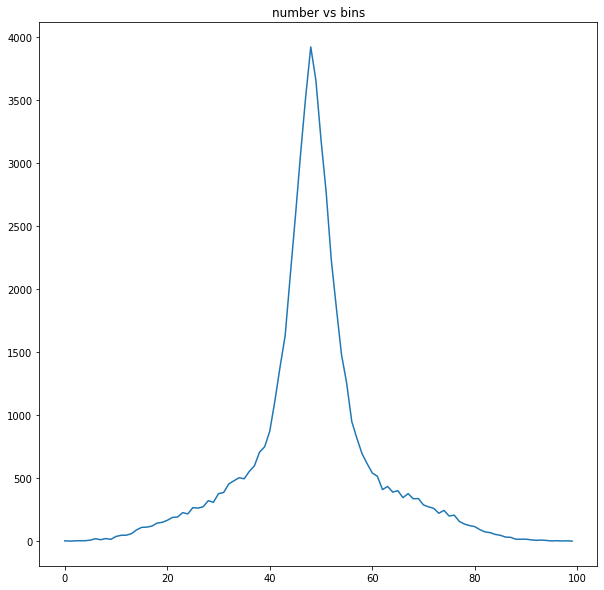

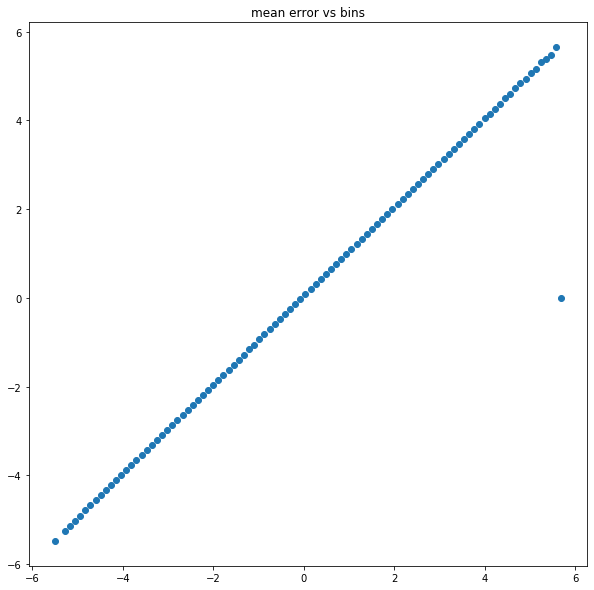

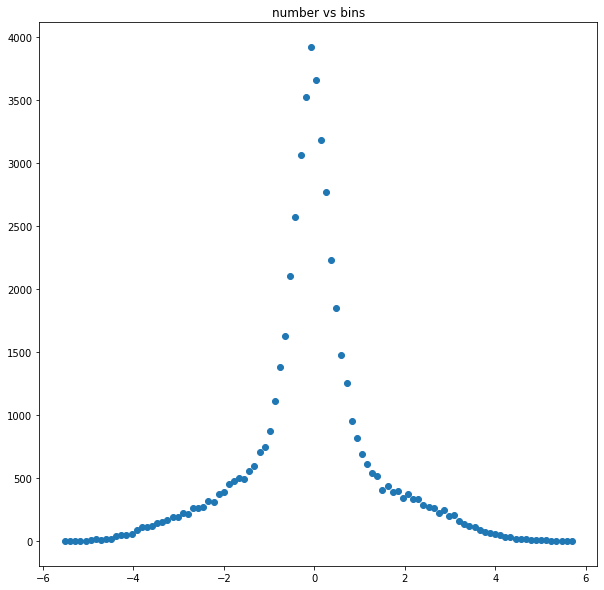

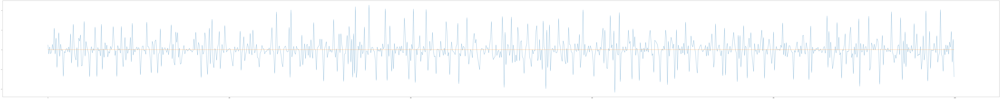

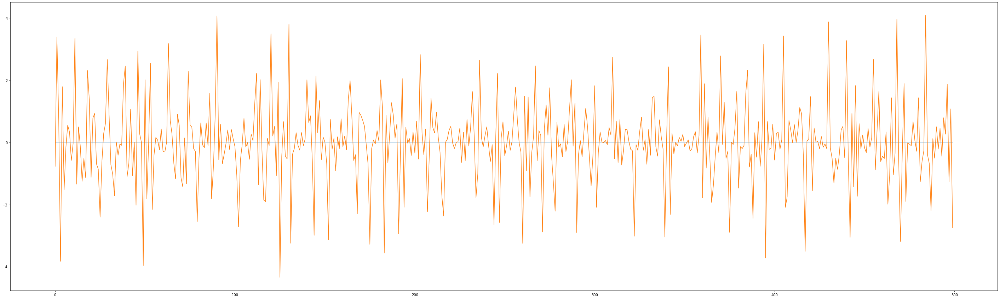

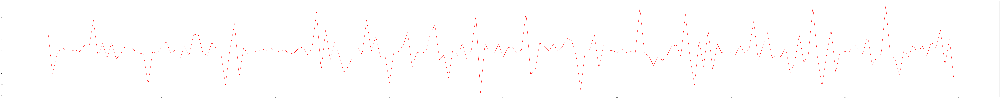

In [15]:
model.save('custom_loss_1')

y_pred = model.predict(X_test[1:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_diff_log, y_pred[:,0],100)


#print(X_val_scaled, y_val_log.values, results)
plt.figure(figsize=(200,20))

plt.plot(y_val_diff_log[:1000])
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_diff_log[500:1000])
plt.show()

plt.figure(figsize=(200,20))
plt.plot(y_pred[800:1000,0])
plt.plot(y_val_diff_log[800:1000],'r')
plt.show()

In [16]:
import tensorflow as tf
tf.keras.metrics.MeanSquaredError

model = tf.keras.models.load_model('logdiff_and_log')

import keras.backend as K

def custom_metric(y_true,y_pred):
        return K.mean(((K.square(y_pred[:,0] - y_true[:,0]))))   
    


def custom_loss(y_true,y_pred):
        return K.mean(((K.square(y_pred[:,0] - y_true[:,0])))) + K.mean(((K.square(y_pred[:,1] - y_true[:,1]))))

In [17]:
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(2))

# #compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',   metrics = [custom_metric, 'mse']) #metrics=[tf.keras.metrics.MeanSquaredError()])

Y_train = np.zeros((y_train_diff_log.shape[0],2))
Y_test = np.zeros((y_val_diff_log.shape[0],2))
Y_train[:,0]=y_train_log[1:]
Y_train[:,1]=y_train_diff_log
Y_test[:,0]=y_val_log[1:]
Y_test[:,1]=y_val_diff_log

model.fit(X[1:,:], Y_train, validation_data=(X_test[1:,:], Y_test), epochs=40)


Train on 1838282 samples, validate on 55209 samples
Epoch 1/40
1838282/1838282 [==============================] - 50s 27us/step - loss: 2.1240 - custom_metric: 3.1515 - mse: 2.1240 - val_loss: 1.1207 - val_custom_metric: 0.7895 - val_mse: 1.1207
Epoch 2/40
1838282/1838282 [==============================] - 48s 26us/step - loss: 0.7581 - custom_metric: 0.5430 - mse: 0.7580 - val_loss: 1.0863 - val_custom_metric: 0.7726 - val_mse: 1.0863
Epoch 3/40
1838282/1838282 [==============================] - 47s 25us/step - loss: 0.7545 - custom_metric: 0.5552 - mse: 0.7545 - val_loss: 1.0538 - val_custom_metric: 0.7358 - val_mse: 1.0538
Epoch 4/40
1838282/1838282 [==============================] - 47s 26us/step - loss: 0.7115 - custom_metric: 0.4893 - mse: 0.7115 - val_loss: 1.0388 - val_custom_metric: 0.7011 - val_mse: 1.0388
Epoch 5/40
1838282/1838282 [==============================] - 46s 25us/step - loss: 0.6991 - custom_metric: 0.4734 - mse: 0.6991 - val_loss: 1.0335 - val_custom_metric: 0.7

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.756459 median ytrue 8.318118323312142


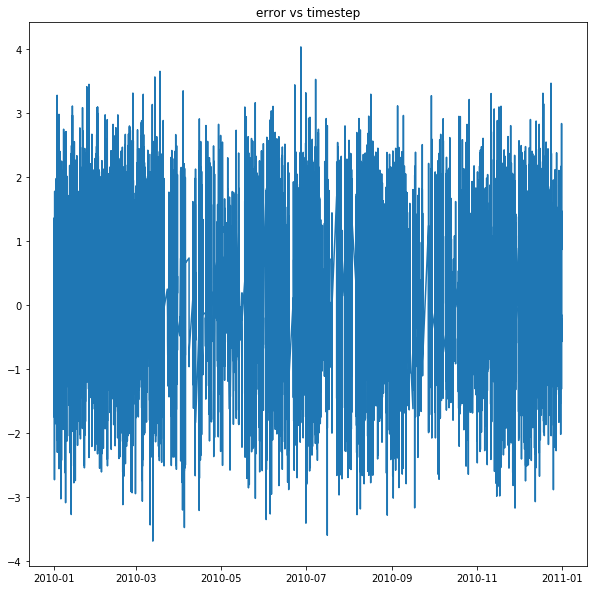

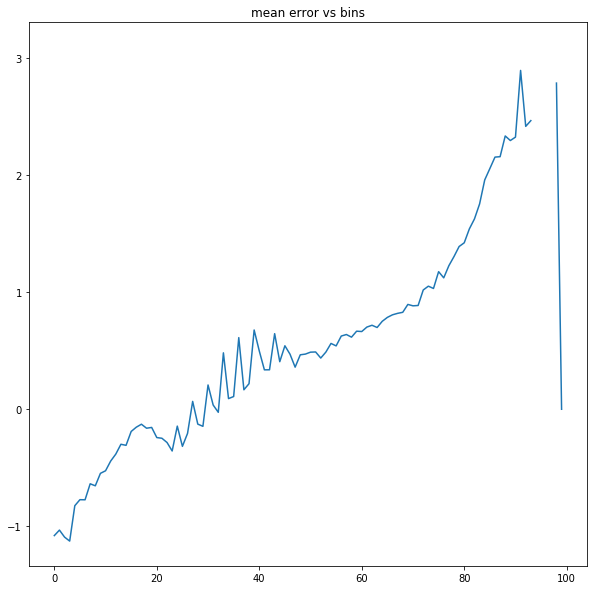

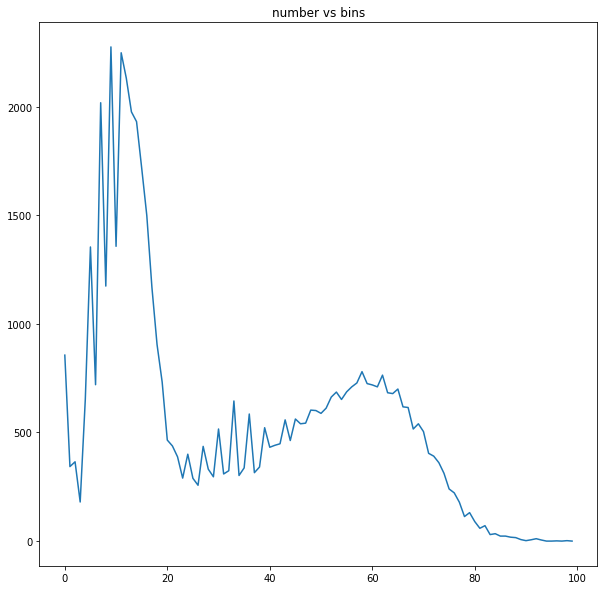

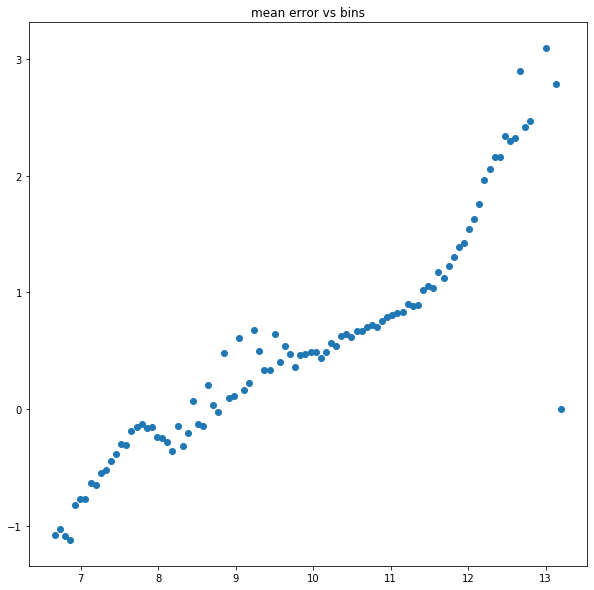

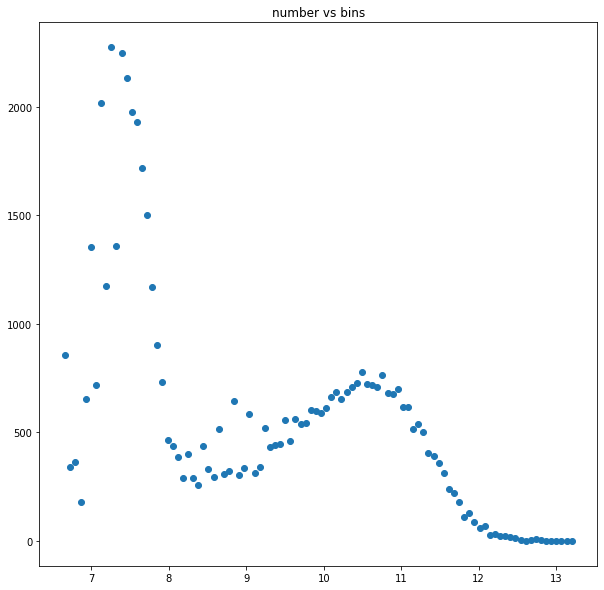

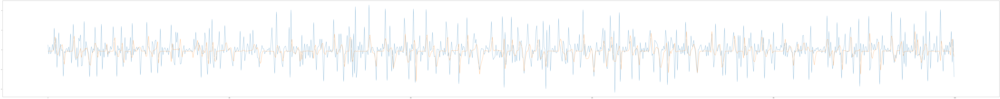

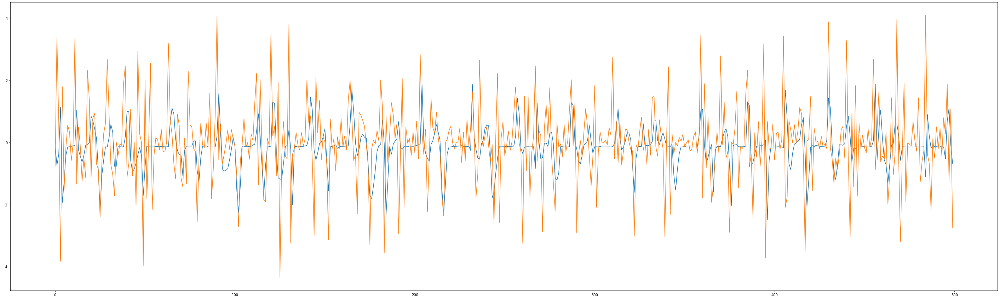

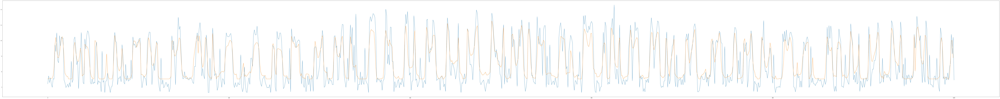

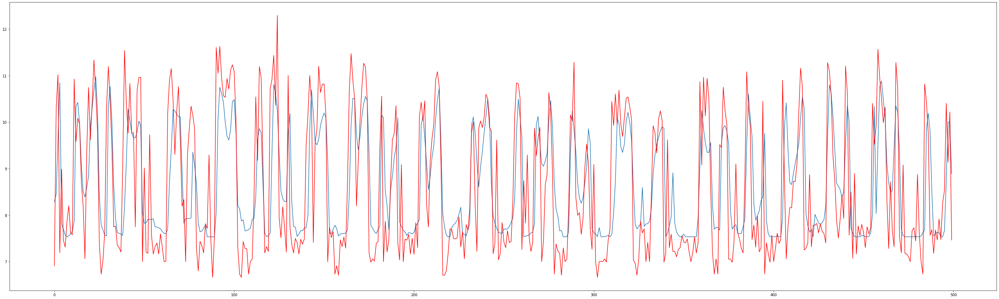

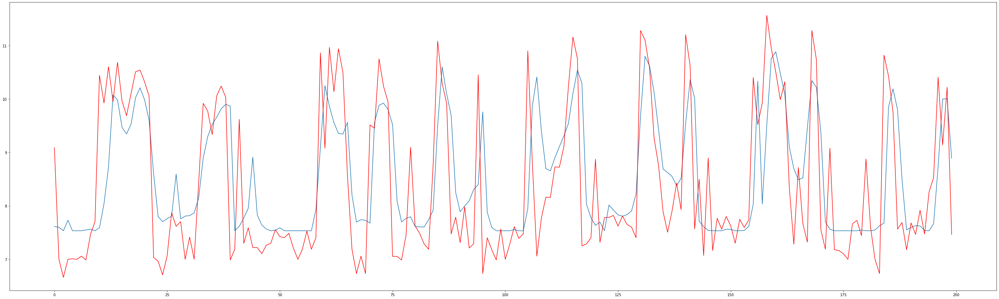

In [18]:
model.save('custom_loss_3')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)



#print(X_val_scaled, y_val_log.values, results)
plt.figure(figsize=(200,20))

plt.plot(y_val_diff_log[:1000])
plt.plot(y_pred[0:1000,1])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,1])
plt.plot(y_val_diff_log[500:1000])
plt.show()

plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1001].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[501:1001].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[801:1001].values,'r')
plt.show()

In [19]:
#model = keras.models.load_model('path/to/location')
#model=None

In [20]:
import tensorflow as tf
tf.keras.metrics.MeanSquaredError

model = tf.keras.models.load_model('logdiff_and_log')

import keras.backend as K

def custom_metric(y_true,y_pred):
        return K.mean(((K.square(y_pred[:,0] - y_true[:,0]))))   
    


def custom_loss(y_true,y_pred):
        return K.mean(((K.square(y_pred[:,0] - y_true[:,0])))) + 4*K.mean(((K.square(y_pred[:,1] - y_true[:,1]))))

In [21]:
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(2))

# #compile model using accuracy to measure model performance
model.compile(loss=custom_loss, optimizer='adam',   metrics = [custom_metric,'mse']) #metrics=[tf.keras.metrics.MeanSquaredError()])

Y_train = np.zeros((y_train_diff_log.shape[0],2))
Y_test = np.zeros((y_val_diff_log.shape[0],2))
Y_train[:,0]=y_train_log[1:]
Y_train[:,1]=y_train_diff_log
Y_test[:,0]=y_val_log[1:]
Y_test[:,1]=y_val_diff_log

model.fit(X[1:,:], Y_train, validation_data=(X_test[1:,:], Y_test), epochs=40)

Train on 1838282 samples, validate on 55209 samples
Epoch 1/40
1838282/1838282 [==============================] - 77s 42us/step - loss: 6.3844 - custom_metric: 1.4326 - mse: 1.3353 - val_loss: 6.6739 - val_custom_metric: 0.8122 - val_mse: 1.1389
Epoch 2/40
1838282/1838282 [==============================] - 82s 44us/step - loss: 4.4176 - custom_metric: 0.5632 - mse: 0.7634 - val_loss: 6.4726 - val_custom_metric: 0.8280 - val_mse: 1.1196
Epoch 3/40
1838282/1838282 [==============================] - 81s 44us/step - loss: 4.2960 - custom_metric: 0.5254 - mse: 0.7340 - val_loss: 6.2947 - val_custom_metric: 0.7909 - val_mse: 1.0835
Epoch 4/40
1838282/1838282 [==============================] - 82s 45us/step - loss: 4.2292 - custom_metric: 0.5200 - mse: 0.7236 - val_loss: 6.2882 - val_custom_metric: 0.7873 - val_mse: 1.0813
Epoch 5/40
1838282/1838282 [==============================] - 70s 38us/step - loss: 4.3663 - custom_metric: 0.6634 - mse: 0.7945 - val_loss: 6.1590 - val_custom_metric: 0.7

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.980123 median ytrue 8.318118323312142


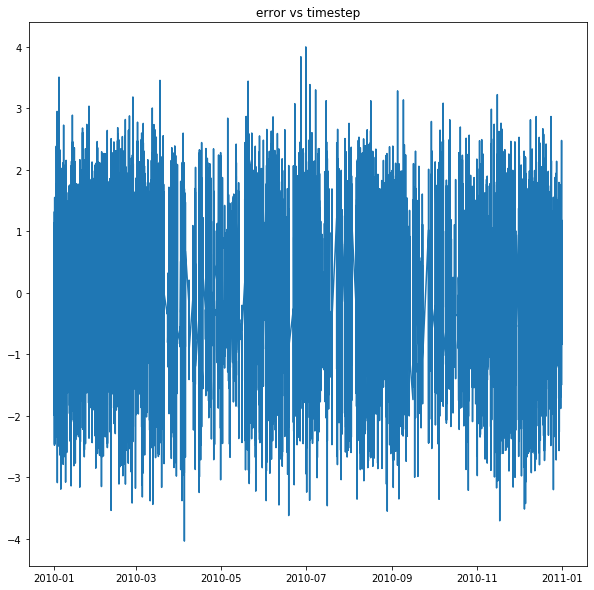

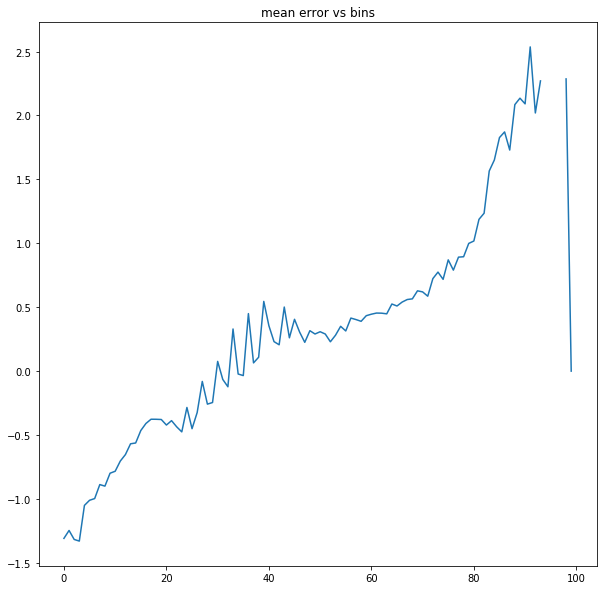

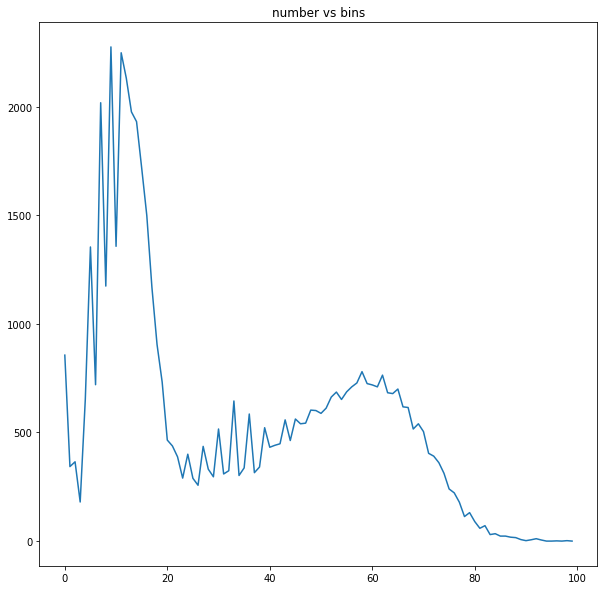

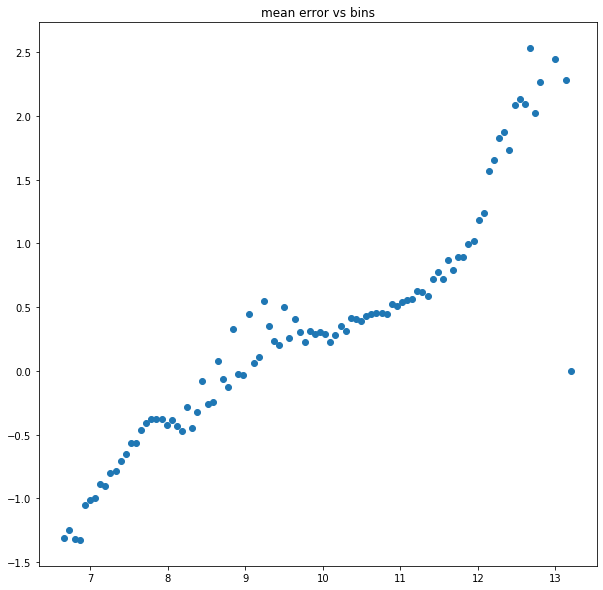

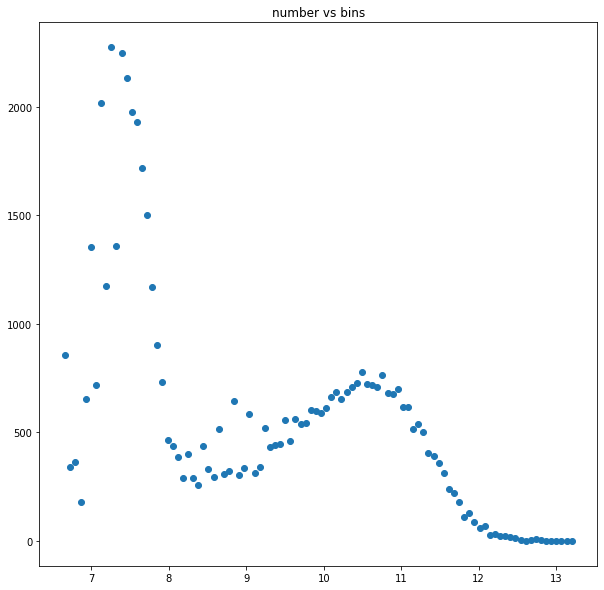

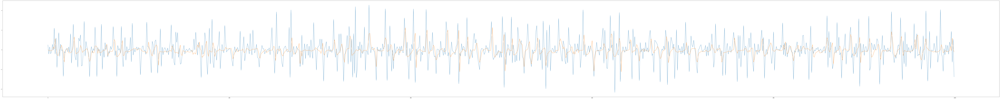

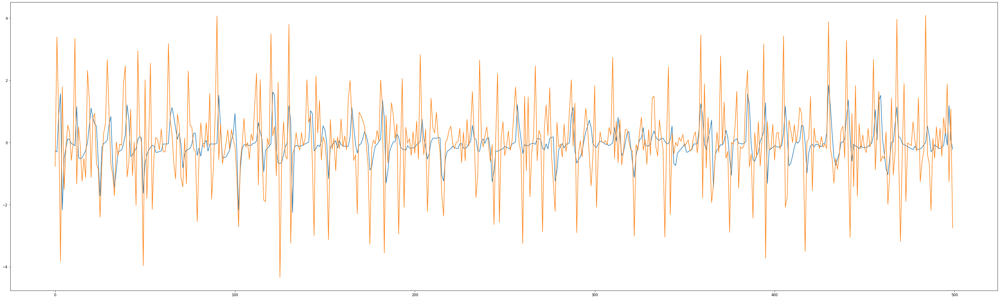

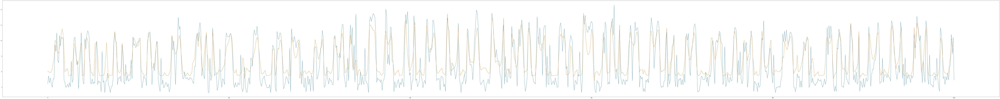

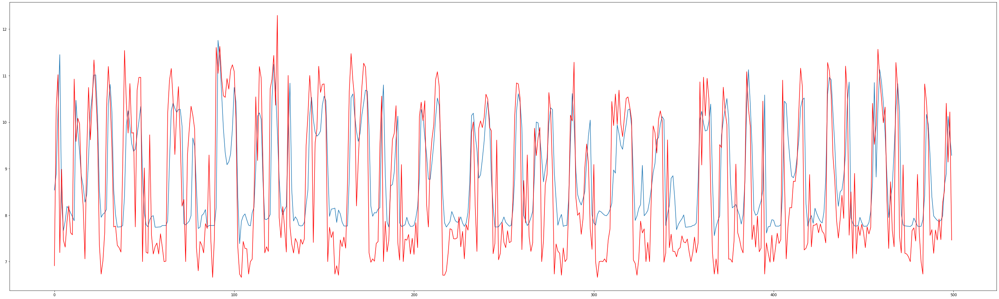

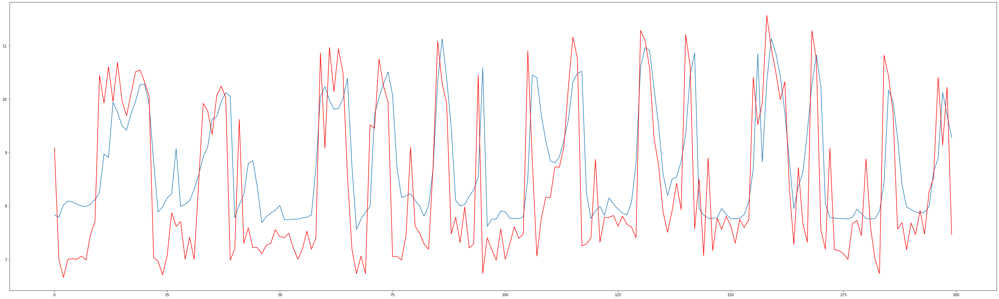

In [22]:
model.save('custom_loss_4')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)



#print(X_val_scaled, y_val_log.values, results)
plt.figure(figsize=(200,20))

plt.plot(y_val_diff_log[:1000])
plt.plot(y_pred[0:1000,1])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,1])
plt.plot(y_val_diff_log[500:1000])
plt.show()

plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1001].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[501:1001].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[801:1001].values,'r')
plt.show()


In [23]:
import keras.backend as K

def custom_loss(y_true,y_pred):

        return K.mean(K.sum(K.square(K.square(y_pred - y_true))))
   



In [24]:

from keras.models import Sequential, Model
from keras.layers import Dense, Conv1D, Flatten, Input, LSTM, TimeDistributed, MaxPooling1D
from keras.layers.merge import concatenate

In [25]:

model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])
model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), epochs=40)


Train on 1838283 samples, validate on 55210 samples
Epoch 1/40
1838283/1838283 [==============================] - 66s 36us/step - loss: 1.5792 - mse: 1.5792 - val_loss: 0.7965 - val_mse: 0.7965
Epoch 2/40
1838283/1838283 [==============================] - 68s 37us/step - loss: 0.5409 - mse: 0.5409 - val_loss: 0.6884 - val_mse: 0.6884
Epoch 3/40
1838283/1838283 [==============================] - 70s 38us/step - loss: 0.6101 - mse: 0.6101 - val_loss: 0.6610 - val_mse: 0.6610
Epoch 4/40
1838283/1838283 [==============================] - 67s 36us/step - loss: 0.5022 - mse: 0.5022 - val_loss: 0.6310 - val_mse: 0.6310
Epoch 5/40
1838283/1838283 [==============================] - 56s 30us/step - loss: 0.4561 - mse: 0.4561 - val_loss: 0.6248 - val_mse: 0.6248
Epoch 6/40
1838283/1838283 [==============================] - 55s 30us/step - loss: 0.4512 - mse: 0.4512 - val_loss: 0.6394 - val_mse: 0.6394
Epoch 7/40
1838283/1838283 [==============================] - 55s 30us/step - loss: 0.4510 - mse

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.78519 median ytrue 8.318118323312142


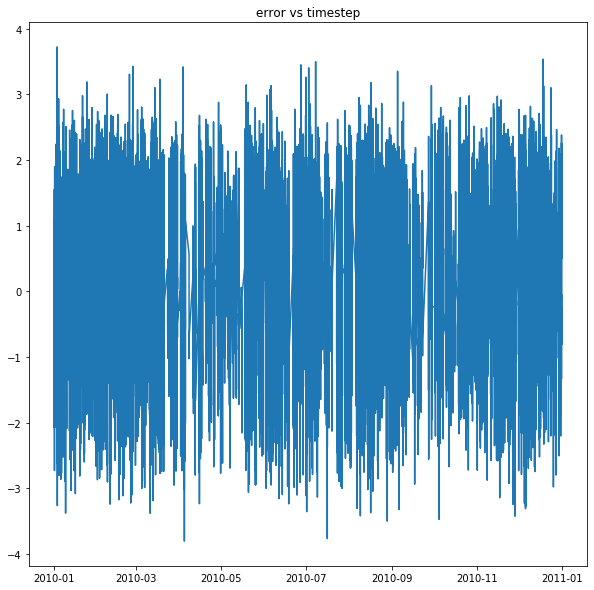

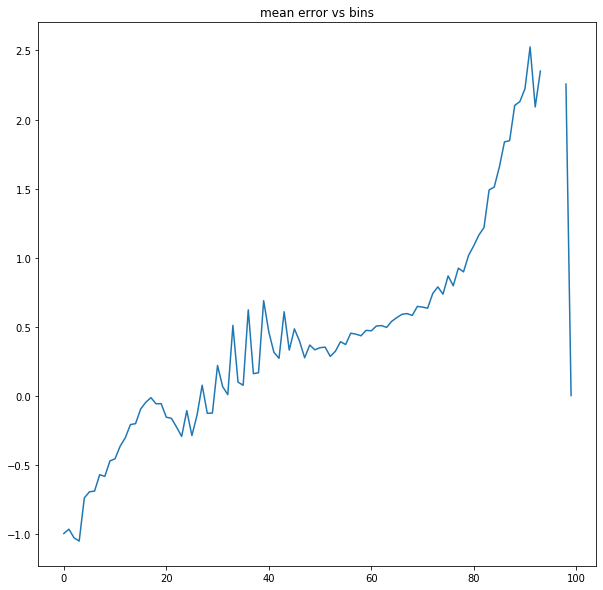

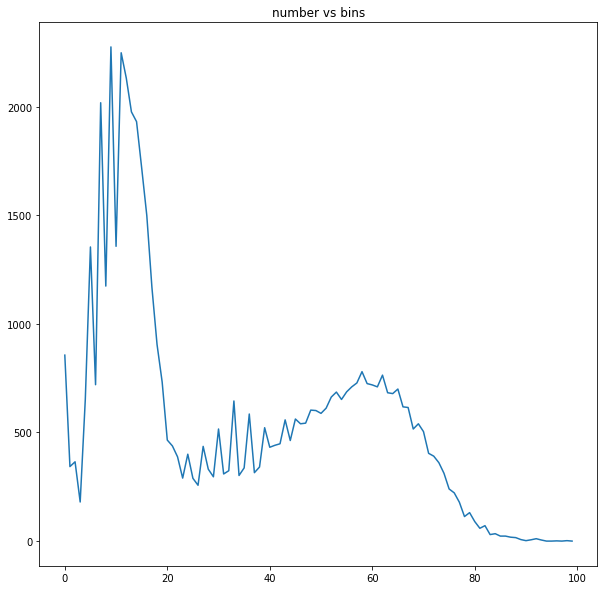

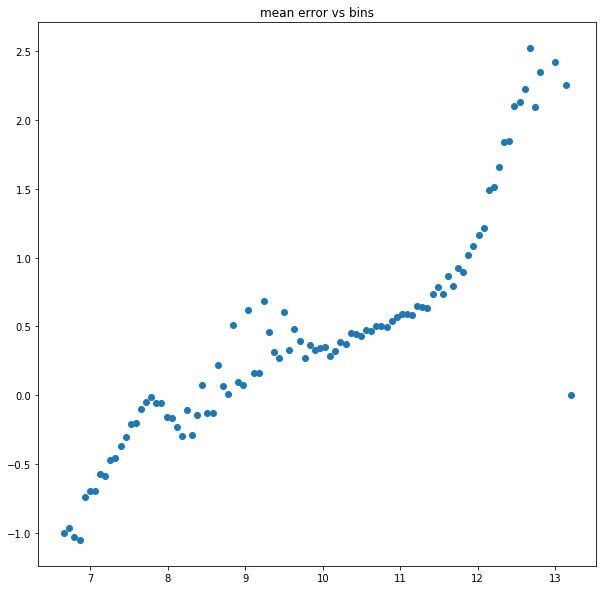

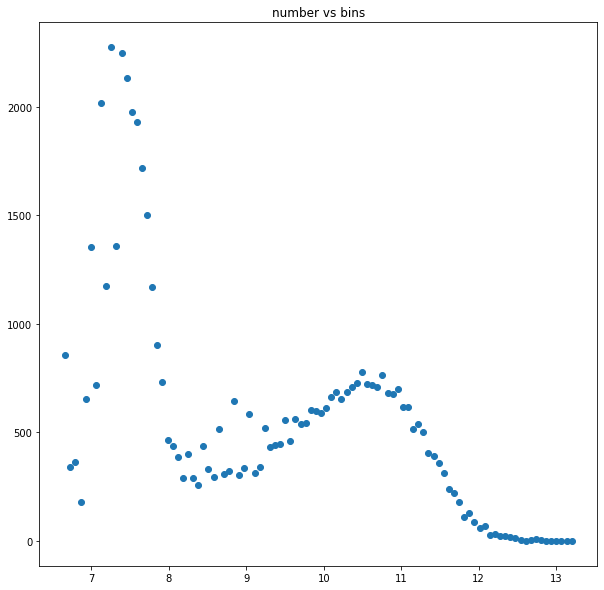

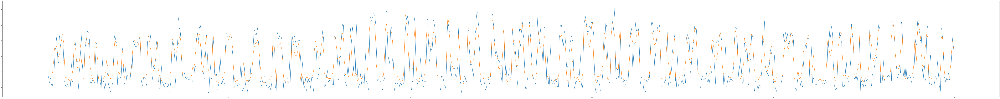

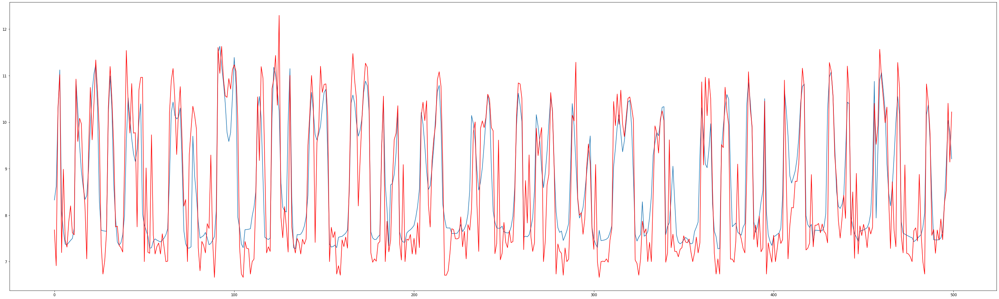

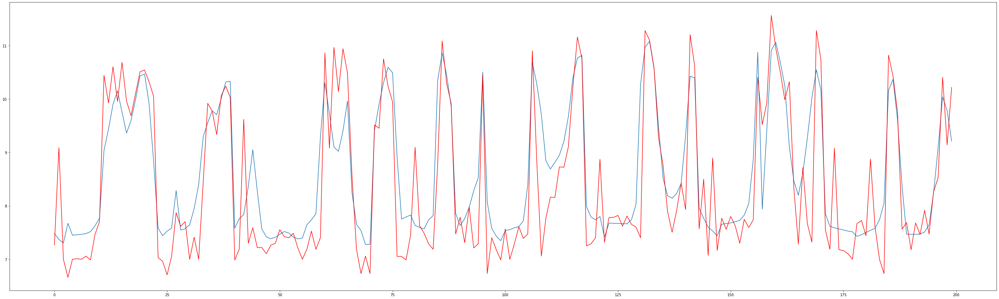

In [26]:
model.save('custom_loss_5')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [27]:
X1=X.reshape((X.shape[0],1,148))
X_test1=X_test.reshape((X_test.shape[0],1,148))


input1 = Input(shape=(1,148))

model=Dense(int(32), activation='relu')(input1)

merged=TimeDistributed(Flatten())(model)
merged=LSTM(8,activation='relu')(merged)

output = Dense(4, activation='relu')(merged)
output = Dense(1)(output)

merged_model = Model(inputs = input1, outputs =output )
merged_model.compile(loss='mse', optimizer='adam', metrics=['mse'])
merged_model.summary()
merged_model.fit(X1, y_train_log, validation_data=(X_test1, y_val_log), epochs=6)



Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 1, 148)            0         
_________________________________________________________________
dense_17 (Dense)             (None, 1, 32)             4768      
_________________________________________________________________
time_distributed_1 (TimeDist (None, 1, 32)             0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 8)                 1312      
_________________________________________________________________
dense_18 (Dense)             (None, 4)                 36        
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 5         
Total params: 6,121
Trainable params: 6,121
Non-trainable params: 0
_________________________________________________________

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.837552 median ytrue 8.318118323312142


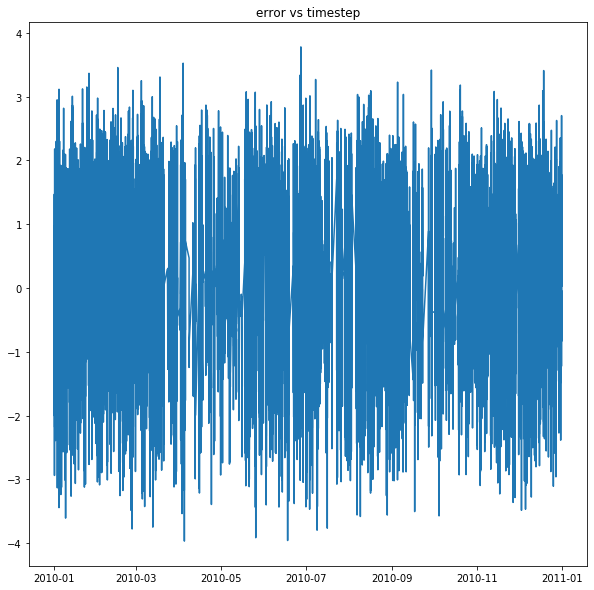

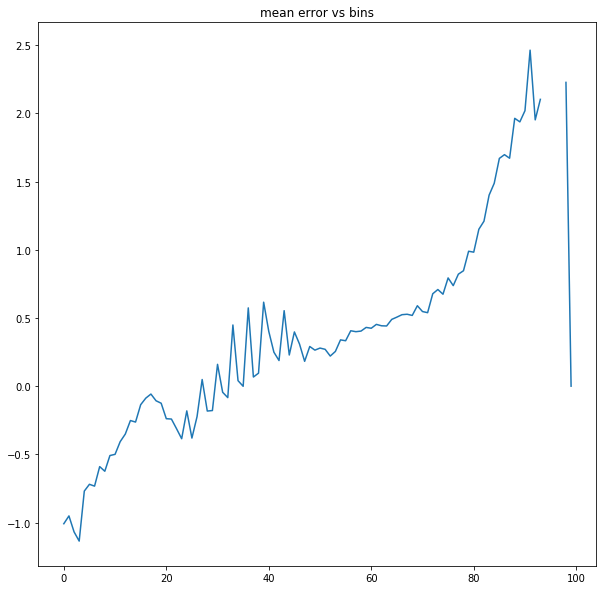

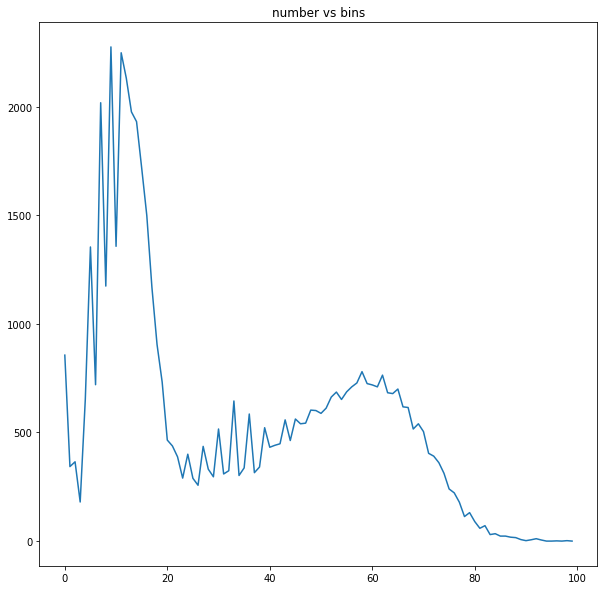

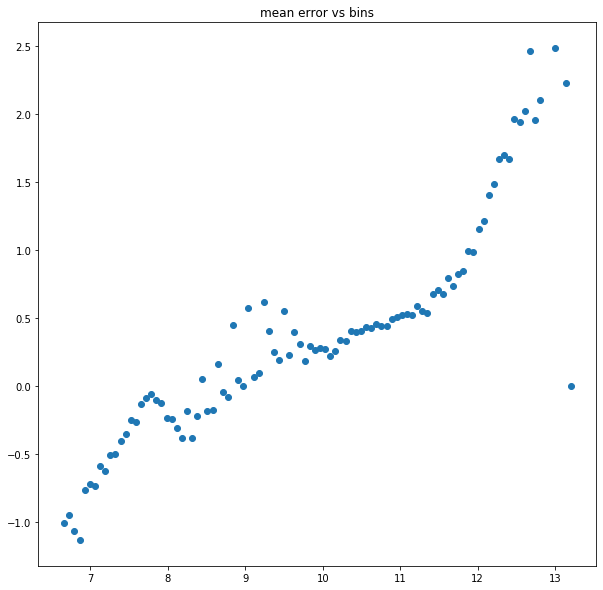

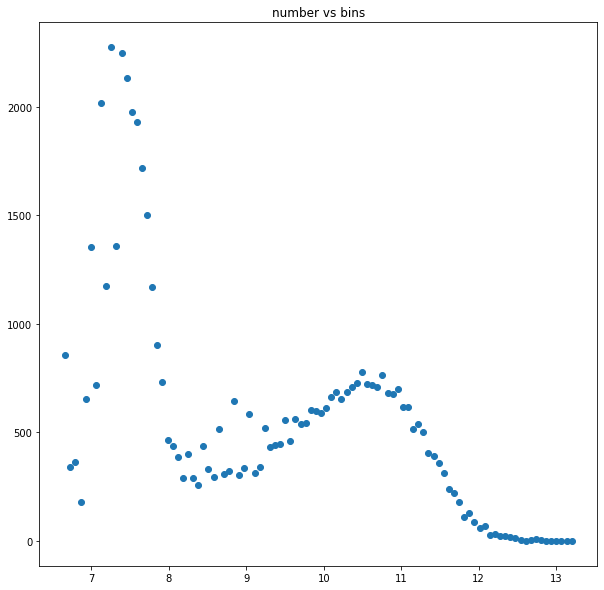

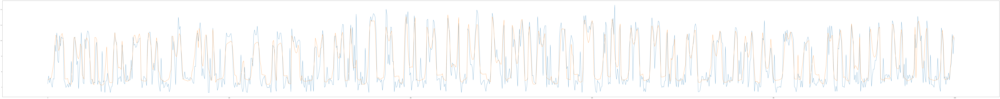

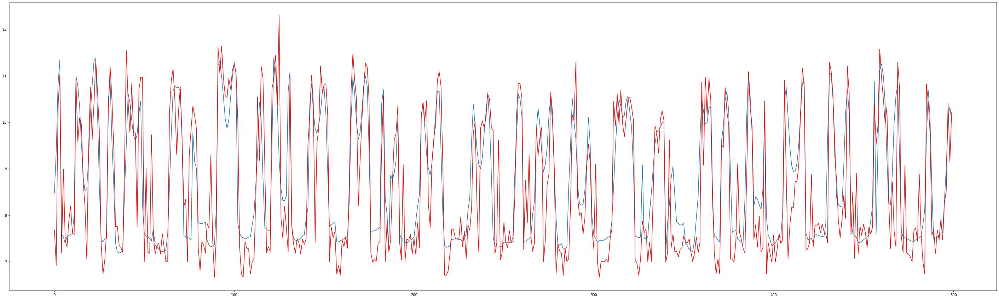

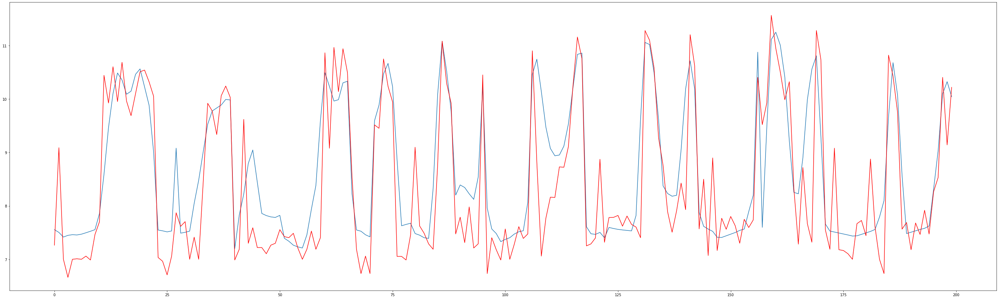

In [28]:
merged_model.save('custom_loss_6')

y_pred = merged_model.predict(X_test1[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [29]:
X1=X.reshape((X.shape[0],1,148))
X_test1=X_test.reshape((X_test.shape[0],1,148))


input1 = Input(shape=(1,148))

model=Dense(int(148), activation='relu')(input1)

merged=TimeDistributed(Flatten())(input1)
merged=LSTM(32,activation='relu')(merged)

output = Dense(4, activation='relu')(merged)
output = Dense(1)(output)

merged_model = Model(inputs = input1, outputs =output )
merged_model.compile(loss='mse', optimizer='adam', metrics=['mse'])
merged_model.summary()
merged_model.fit(X1, y_train_log, validation_data=(X_test1, y_val_log), epochs=40)


Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 1, 148)            0         
_________________________________________________________________
time_distributed_2 (TimeDist (None, 1, 148)            0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                23168     
_________________________________________________________________
dense_21 (Dense)             (None, 4)                 132       
_________________________________________________________________
dense_22 (Dense)             (None, 1)                 5         
Total params: 23,305
Trainable params: 23,305
Non-trainable params: 0
_________________________________________________________________
Train on 1838283 samples, validate on 55210 samples
Epoch 1/40
1838283/1838283 [==============================] - 69s 37u

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.8190565 median ytrue 8.318118323312142


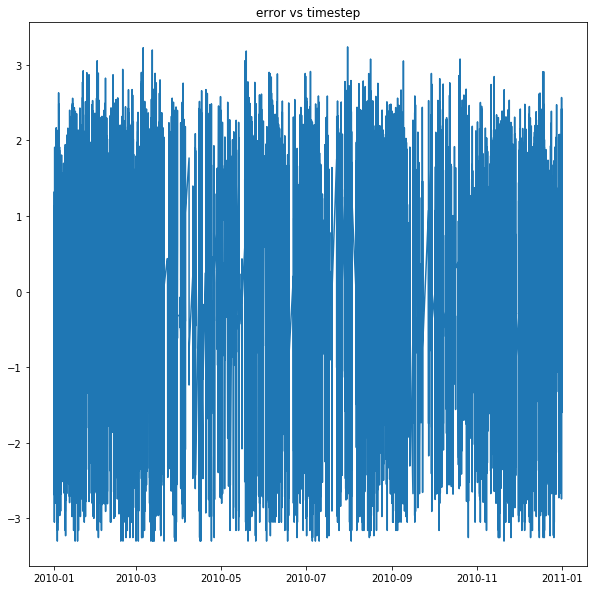

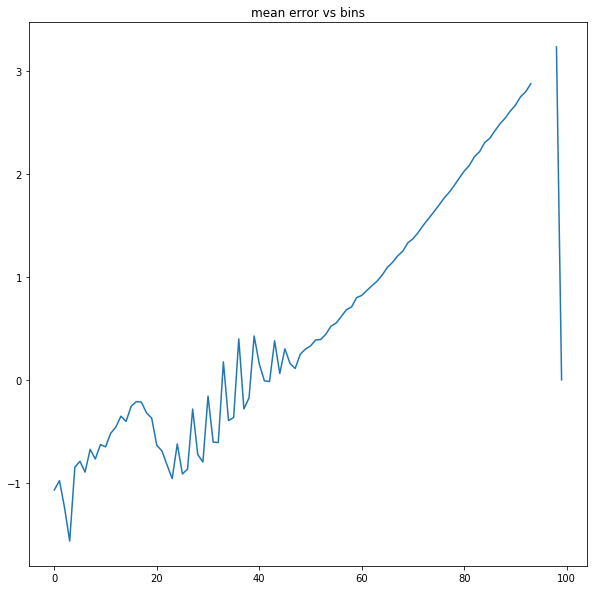

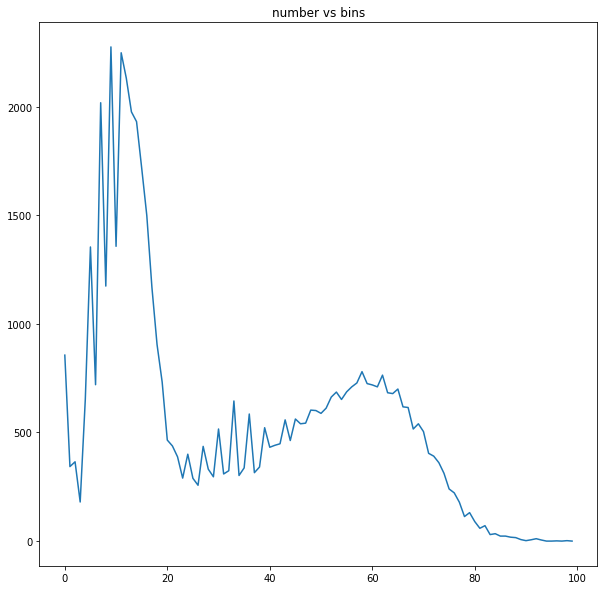

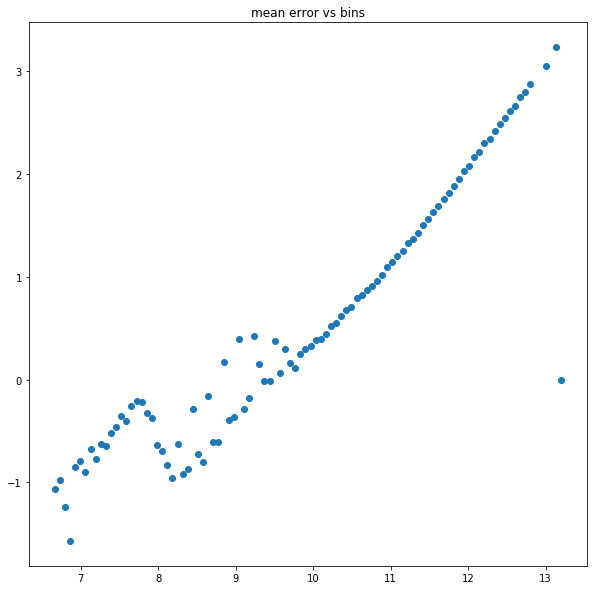

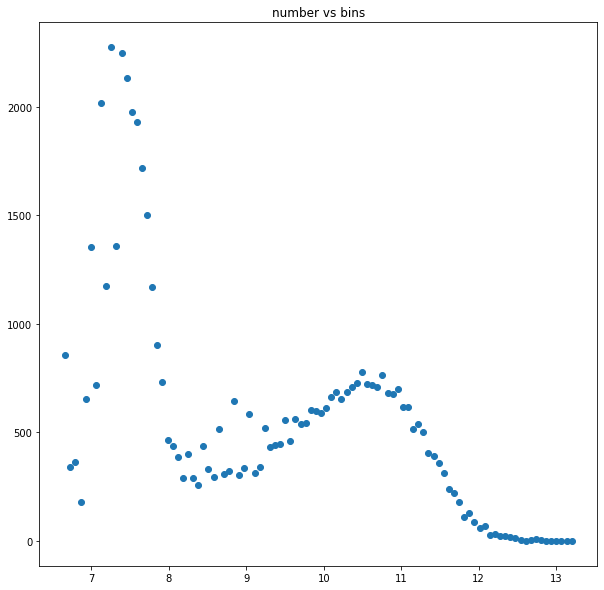

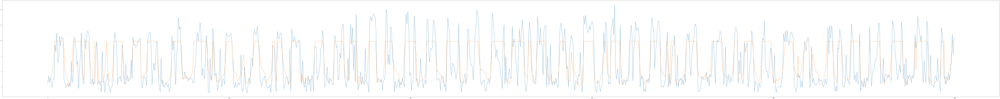

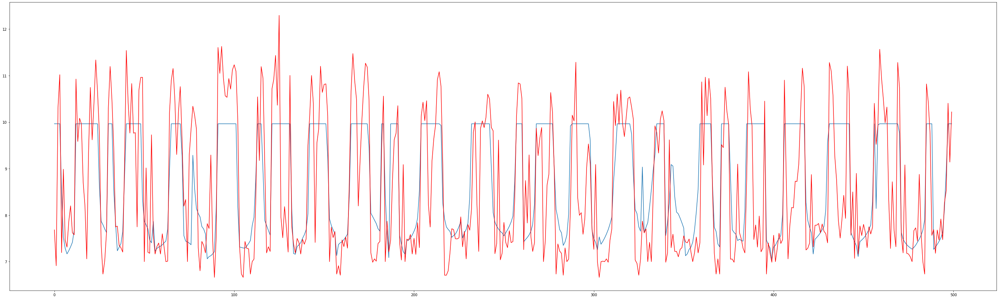

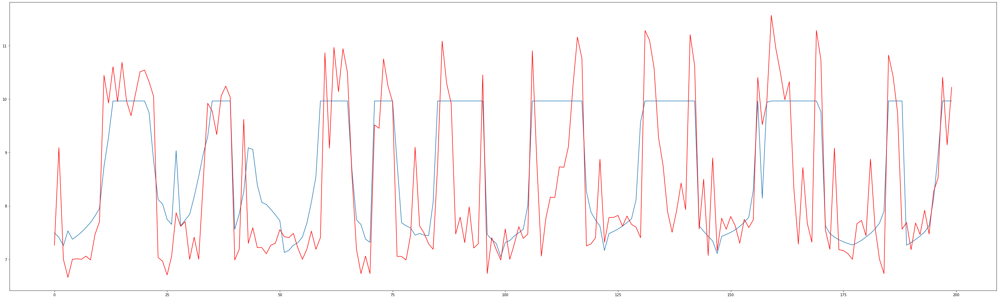

In [30]:
merged_model.save('custom_loss_7')

y_pred = merged_model.predict(X_test1[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()


In [31]:
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten
#create model
model = Sequential()

model.add(Dense(int(32), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), epochs=40)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/40
1838283/1838283 [==============================] - 78s 43us/step - loss: 1.6567 - mse: 1.6567 - val_loss: 0.8173 - val_mse: 0.8173
Epoch 2/40
1838283/1838283 [==============================] - 78s 42us/step - loss: 0.5494 - mse: 0.5494 - val_loss: 0.7382 - val_mse: 0.7382
Epoch 3/40
1838283/1838283 [==============================] - 78s 43us/step - loss: 0.5665 - mse: 0.5665 - val_loss: 0.7702 - val_mse: 0.7702
Epoch 4/40
1838283/1838283 [==============================] - 79s 43us/step - loss: 0.5163 - mse: 0.5163 - val_loss: 0.6961 - val_mse: 0.6961
Epoch 5/40
1838283/1838283 [==============================] - 79s 43us/step - loss: 0.4741 - mse: 0.4741 - val_loss: 0.6777 - val_mse: 0.6777
Epoch 6/40
1838283/1838283 [==============================] - 75s 41us/step - loss: 0.4683 - mse: 0.4683 - val_loss: 0.6628 - val_mse: 0.6628
Epoch 7/40
1838283/1838283 [==============================] - 71s 39us/step - loss: 0.4787 - mse

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.829389 median ytrue 8.318118323312142


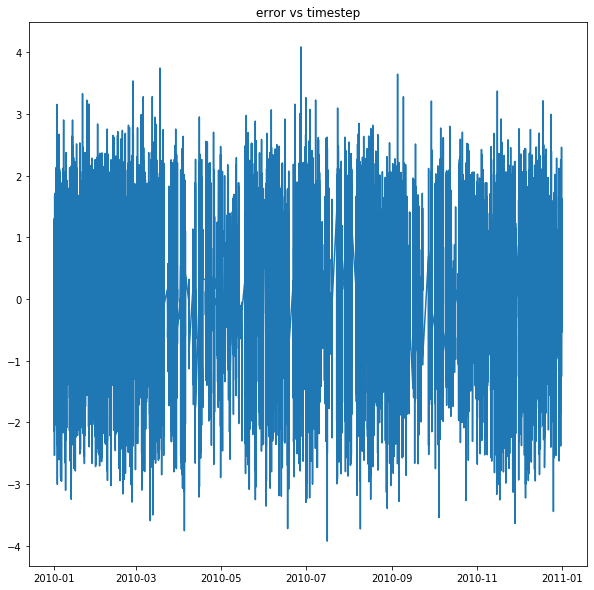

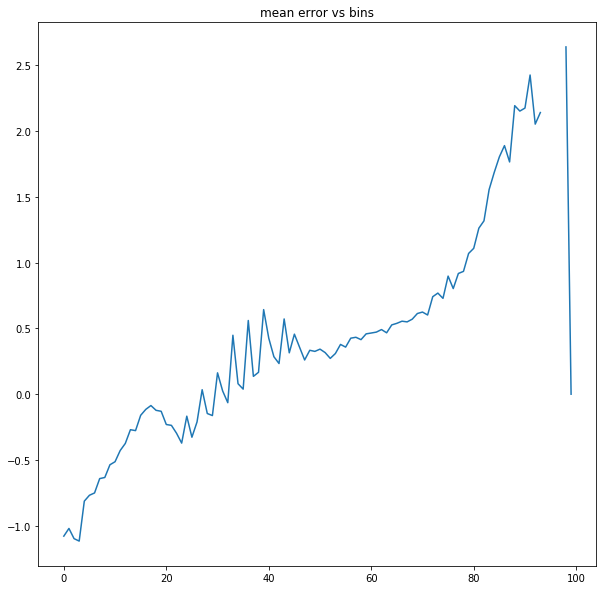

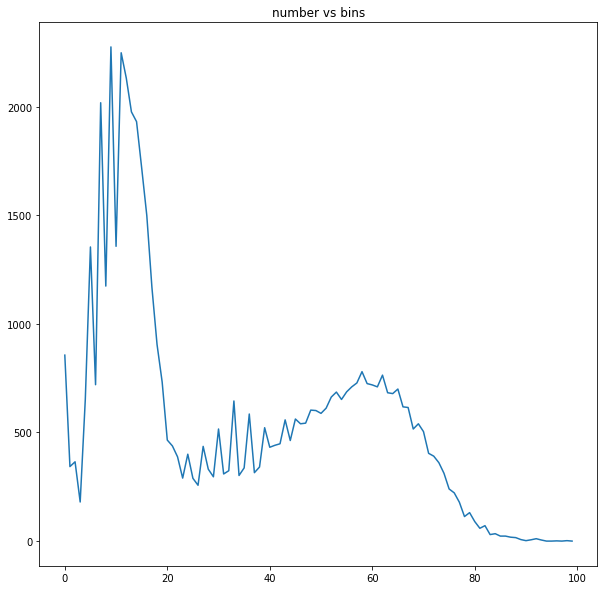

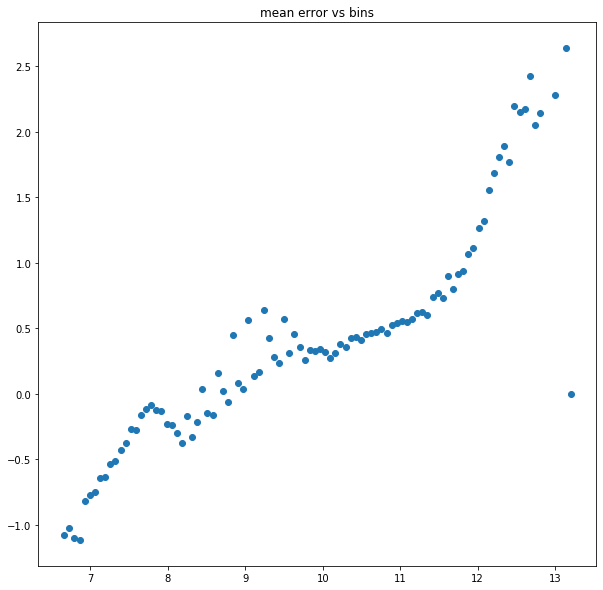

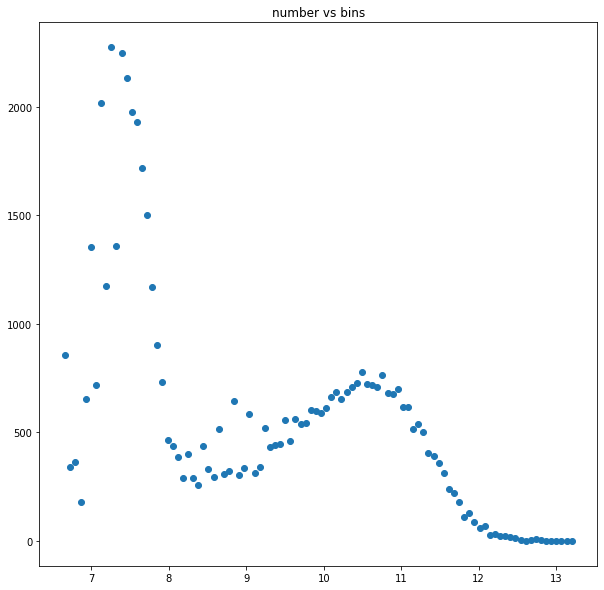

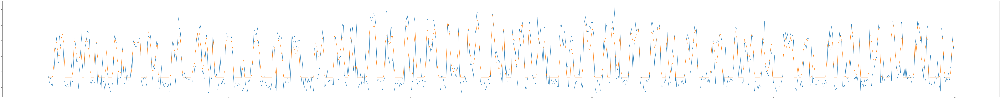

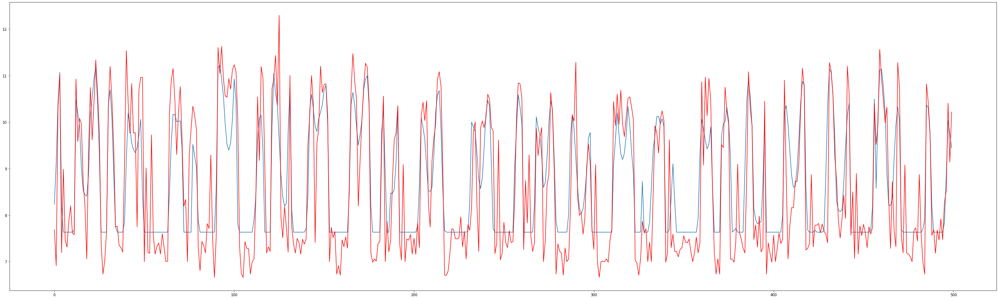

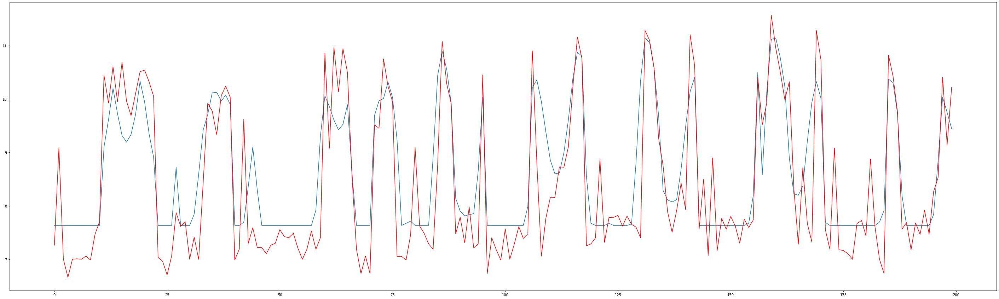

In [32]:
model.save('custom_loss_8')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [33]:
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten
#create model
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#compile model using accuracy to measure model performance
model.compile(loss='mae', optimizer='adam', metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=8192, epochs=40)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 2.3748 - mse: 20.2039 - val_loss: 1.2645 - val_mse: 2.3426
Epoch 2/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.9730 - mse: 3.6481 - val_loss: 1.1390 - val_mse: 1.8192
Epoch 3/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.8702 - mse: 2.2597 - val_loss: 1.0944 - val_mse: 1.6842
Epoch 4/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.8360 - mse: 1.4644 - val_loss: 1.0837 - val_mse: 1.6426
Epoch 5/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.8124 - mse: 1.5438 - val_loss: 1.0380 - val_mse: 1.5063
Epoch 6/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.7205 - mse: 1.1008 - val_loss: 0.8207 - val_mse: 0.9912
Epoch 7/40
1838283/1838283 [==============================] - 6s 3us/step - loss: 0.5985 - mse: 0.7774 - va

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.914296 median ytrue 8.318118323312142


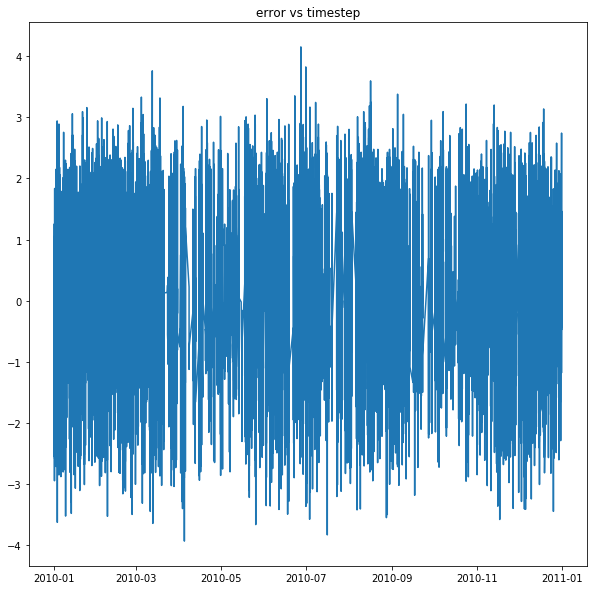

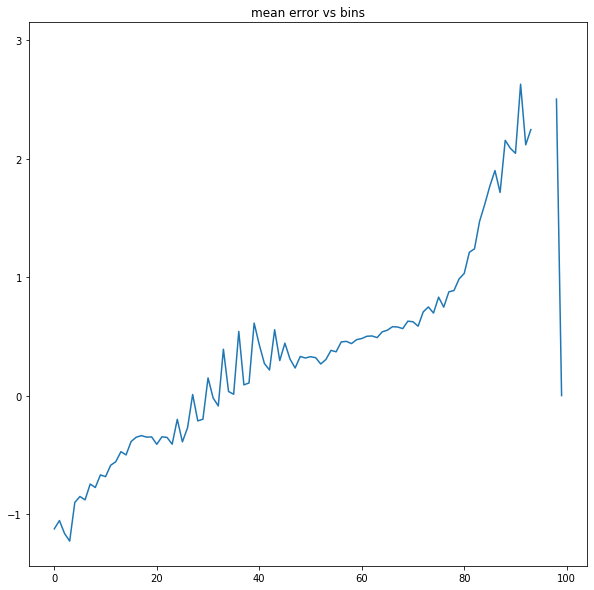

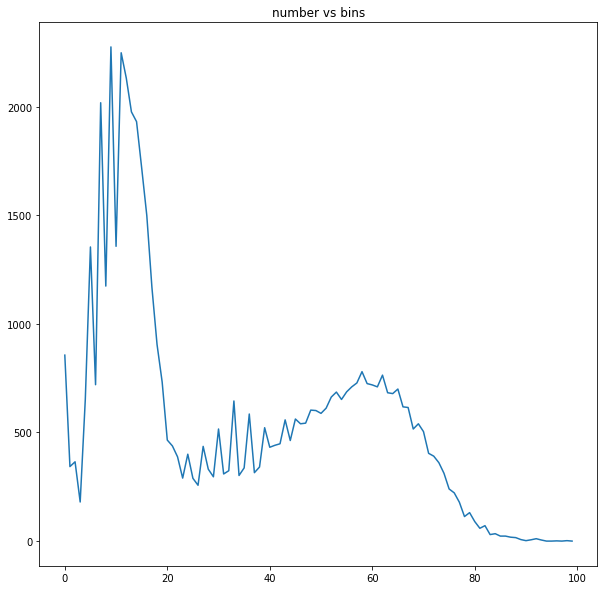

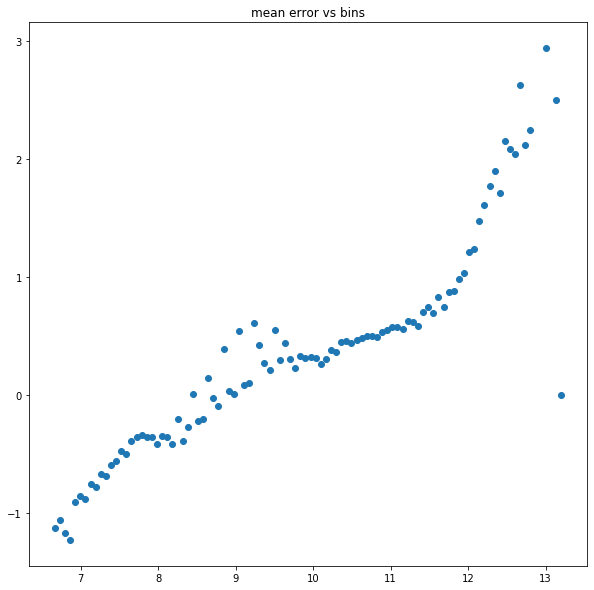

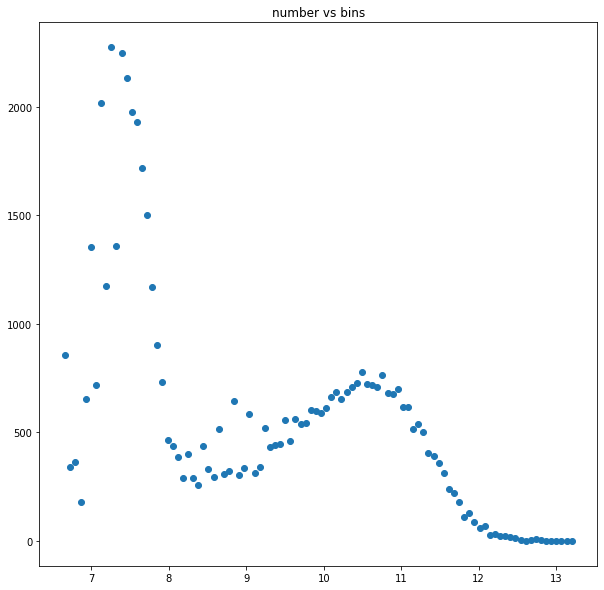

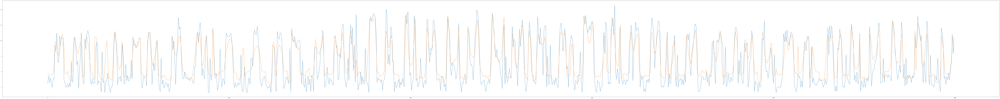

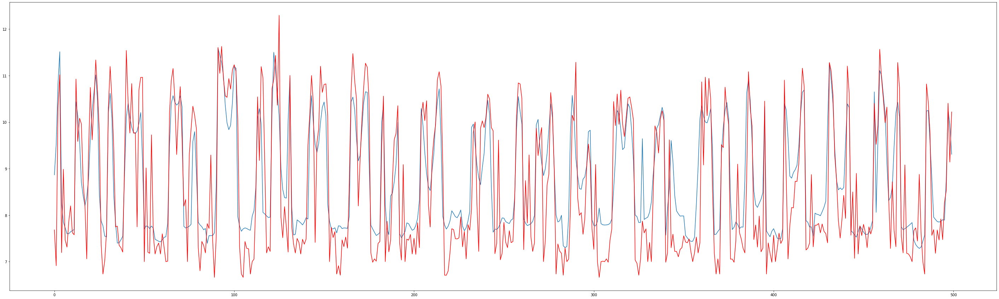

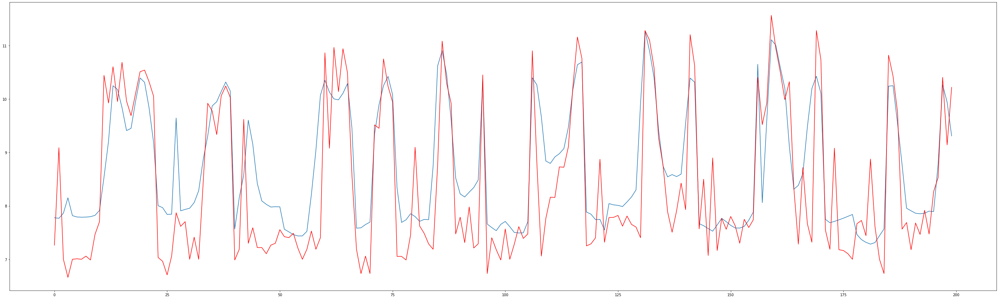

In [34]:
model.save('custom_loss_9')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [35]:
def tilted_loss(q,y,f):
    e = (y-f)
    return K.mean(K.maximum(q*e, (q-1)*e), axis=-1)

In [36]:
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten
import keras.backend as K

#create model
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#     model.compile(loss=lambda y,f: tilted_loss(q,y,f), optimizer='adadelta')
#     model.fit(mcycle.times.values, mcycle.accel.values, epochs=2000, batch_size=32, verbose=0)
    
q=.8
#compile model using accuracy to measure model performance
model.compile(loss=lambda y,f: tilted_loss(q,y,f), optimizer='adam', batch_size=8192, metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), epochs=40)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/40
1838283/1838283 [==============================] - 53s 29us/step - loss: 0.2234 - mse: 4.7549 - val_loss: 0.2497 - val_mse: 1.0682
Epoch 2/40
1838283/1838283 [==============================] - 60s 33us/step - loss: 0.1816 - mse: 1.0149 - val_loss: 0.2388 - val_mse: 1.2379
Epoch 3/40
1838283/1838283 [==============================] - 58s 32us/step - loss: 0.1755 - mse: 0.8722 - val_loss: 0.2246 - val_mse: 1.1037
Epoch 4/40
1838283/1838283 [==============================] - 56s 30us/step - loss: 0.1722 - mse: 0.8489 - val_loss: 0.2202 - val_mse: 0.9650
Epoch 5/40
1838283/1838283 [==============================] - 55s 30us/step - loss: 0.1706 - mse: 0.8127 - val_loss: 0.2180 - val_mse: 0.9395
Epoch 6/40
1838283/1838283 [==============================] - 55s 30us/step - loss: 0.1696 - mse: 0.7875 - val_loss: 0.2152 - val_mse: 0.9595
Epoch 7/40
1838283/1838283 [==============================] - 56s 30us/step - loss: 0.1688 - mse

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 9.244553 median ytrue 8.318118323312142


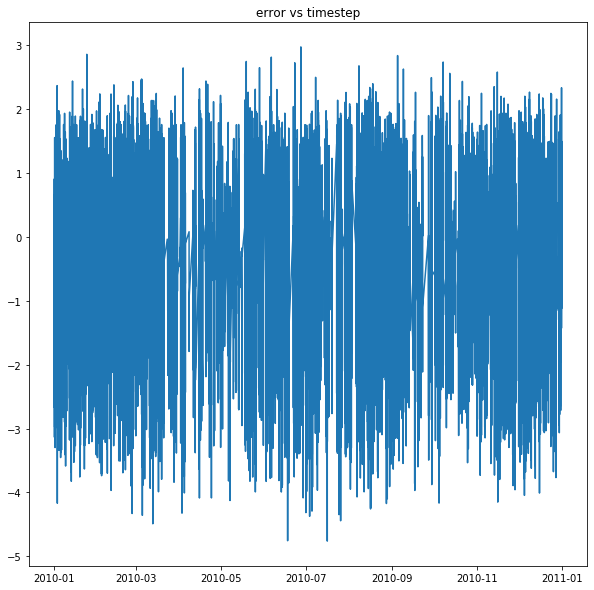

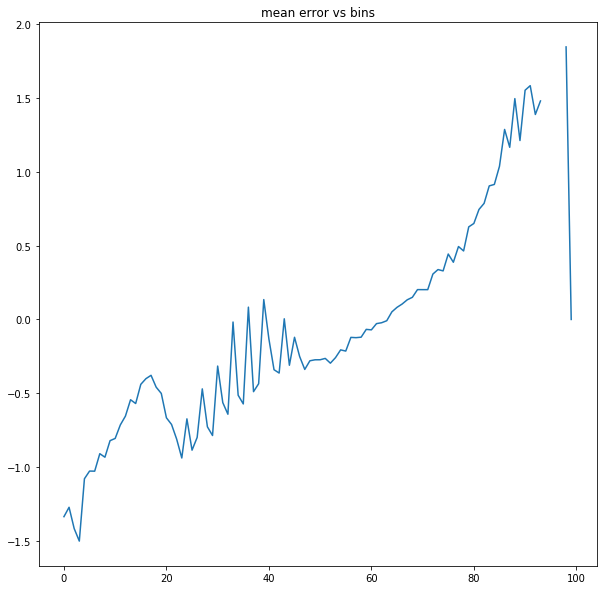

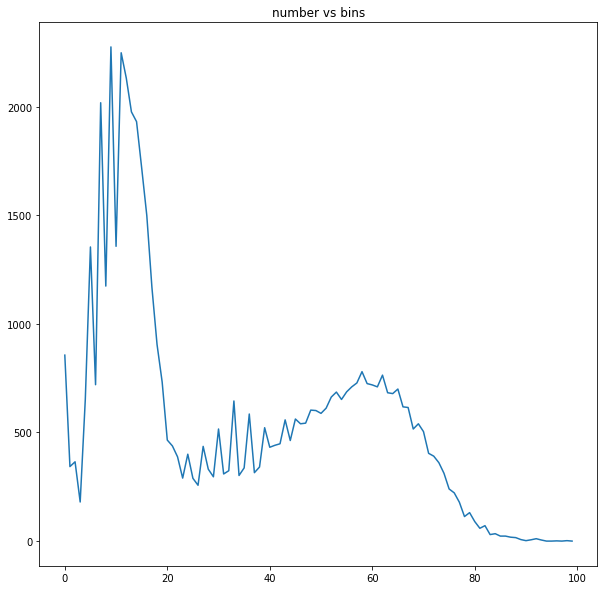

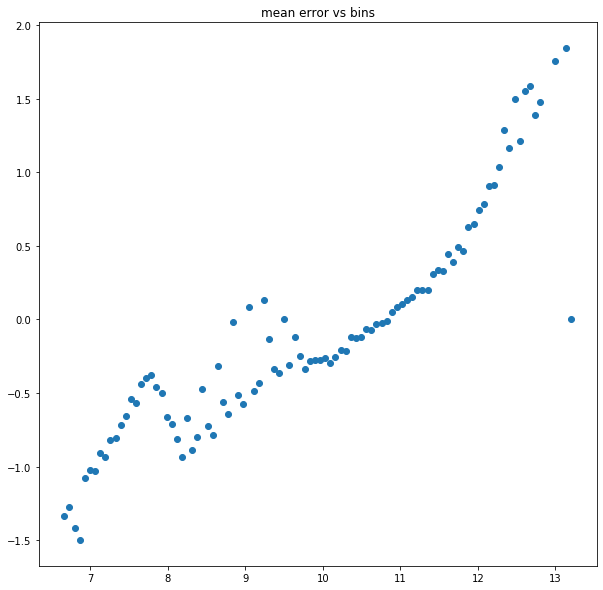

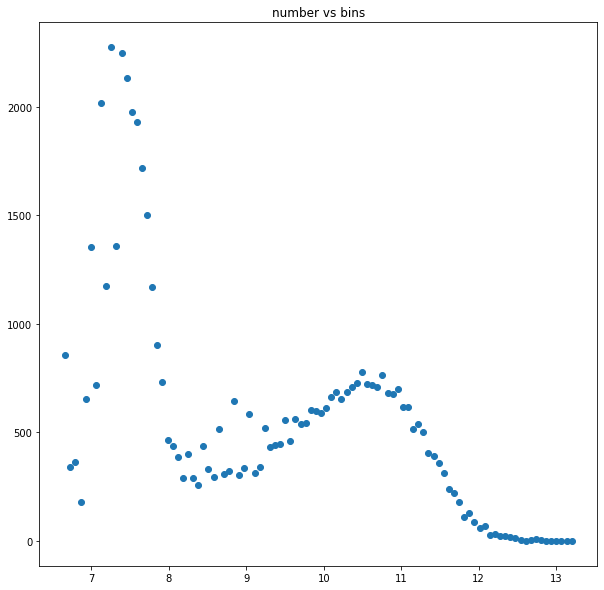

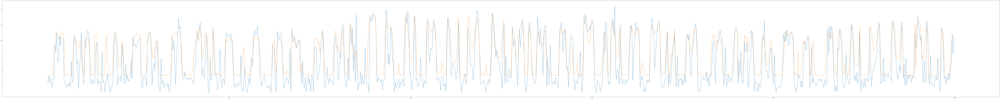

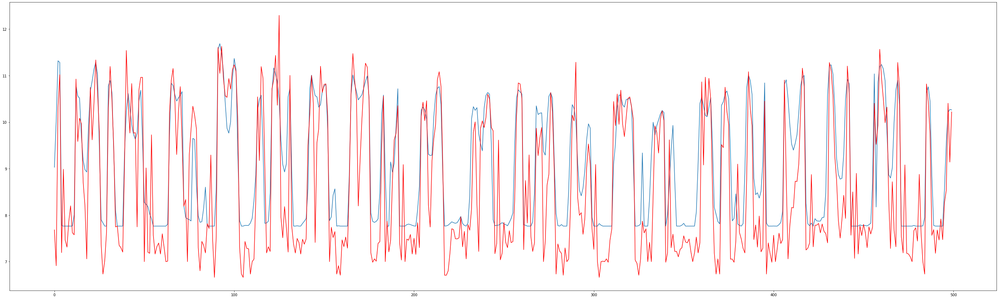

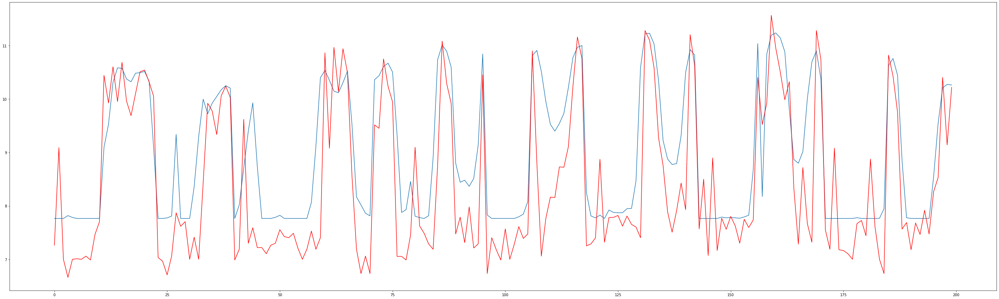

In [37]:
model.save('custom_loss_10')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [38]:
def tilted_loss2(avg,y,f):
    #e = K.abs(y-f)
    #avg=K.mean(y)
    #weights= K.abs((y-avg)/avg)
    #return K.mean(e*weights)
    #return K.mean(K.abs(y-f)*K.abs((y-avg)/avg))
    return K.mean(K.square(y-f)*K.abs((y-avg)/avg))

In [39]:
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten
import keras.backend as K

#create model
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

#     model.compile(loss=lambda y,f: tilted_loss(q,y,f), optimizer='adadelta')
#     model.fit(mcycle.times.values, mcycle.accel.values, epochs=2000, batch_size=32, verbose=0)
    
#q=.8
avg=np.median(y_train_log.values)
#compile model using accuracy to measure model performance
model.compile(loss=lambda y,f: tilted_loss2(avg,y,f), optimizer='adam', batch_size=8192, metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), epochs=100)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/100
1838283/1838283 [==============================] - 52s 28us/step - loss: 0.4352 - mse: 4.8549 - val_loss: 0.1115 - val_mse: 0.7301
Epoch 2/100
1838283/1838283 [==============================] - 52s 28us/step - loss: 0.0814 - mse: 0.8675 - val_loss: 0.1014 - val_mse: 0.6814
Epoch 3/100
1838283/1838283 [==============================] - 55s 30us/step - loss: 0.0660 - mse: 0.6048 - val_loss: 0.0997 - val_mse: 0.7181
Epoch 4/100
1838283/1838283 [==============================] - 52s 28us/step - loss: 0.0660 - mse: 0.6116 - val_loss: 0.0976 - val_mse: 0.7027
Epoch 5/100
1838283/1838283 [==============================] - 54s 29us/step - loss: 0.0632 - mse: 0.5821 - val_loss: 0.0950 - val_mse: 0.6874
Epoch 6/100
1838283/1838283 [==============================] - 53s 29us/step - loss: 0.0622 - mse: 0.5708 - val_loss: 0.0974 - val_mse: 0.7081
Epoch 7/100
1838283/1838283 [==============================] - 52s 28us/step - loss: 0.061

1838283/1838283 [==============================] - 50s 27us/step - loss: 0.0554 - mse: 0.5162 - val_loss: 0.0896 - val_mse: 0.6390
Epoch 58/100
1838283/1838283 [==============================] - 49s 27us/step - loss: 0.0591 - mse: 0.5381 - val_loss: 0.0883 - val_mse: 0.6534
Epoch 59/100
1838283/1838283 [==============================] - 49s 27us/step - loss: 0.0552 - mse: 0.5157 - val_loss: 0.0913 - val_mse: 0.6537
Epoch 60/100
1838283/1838283 [==============================] - 50s 27us/step - loss: 0.0554 - mse: 0.5167 - val_loss: 0.0885 - val_mse: 0.6641
Epoch 61/100
1838283/1838283 [==============================] - 49s 27us/step - loss: 0.0551 - mse: 0.5143 - val_loss: 0.0891 - val_mse: 0.6333
Epoch 62/100
1838283/1838283 [==============================] - 49s 27us/step - loss: 0.0552 - mse: 0.5151 - val_loss: 0.0908 - val_mse: 0.6504
Epoch 63/100
1838283/1838283 [==============================] - 53s 29us/step - loss: 0.0553 - mse: 0.5162 - val_loss: 0.0903 - val_mse: 0.6393
Epoch

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.88156 median ytrue 8.318118323312142


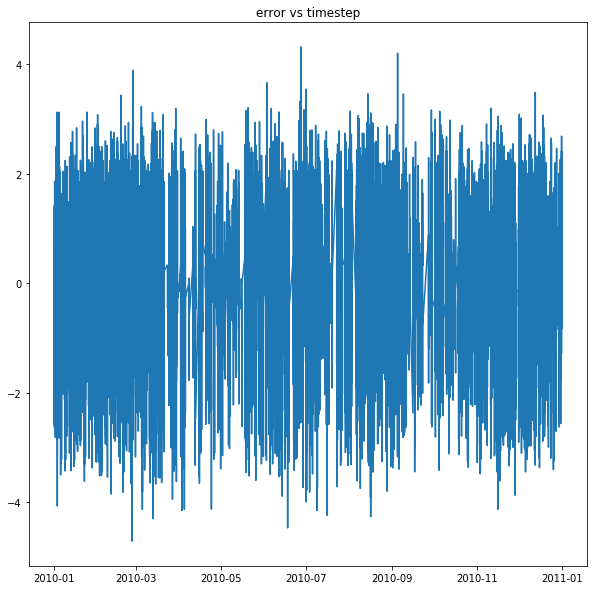

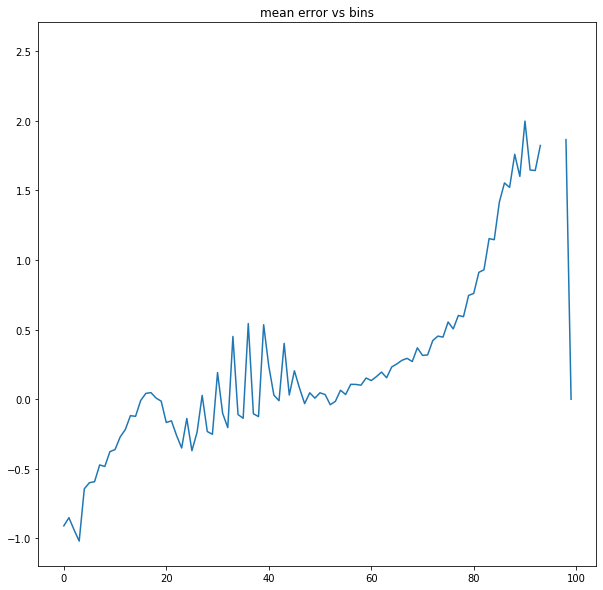

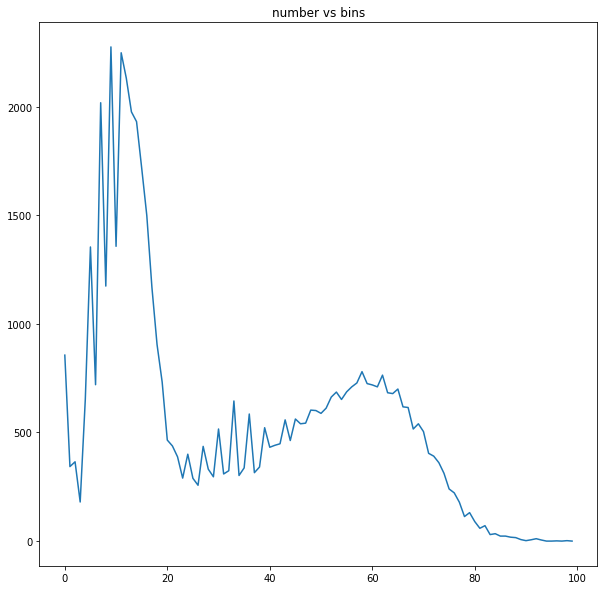

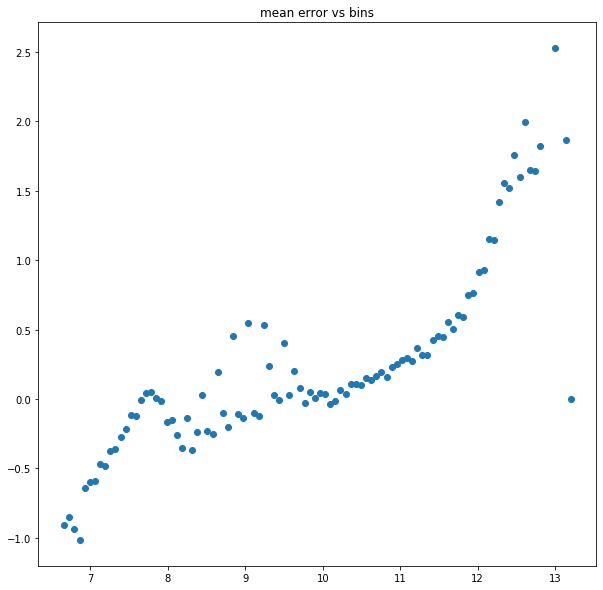

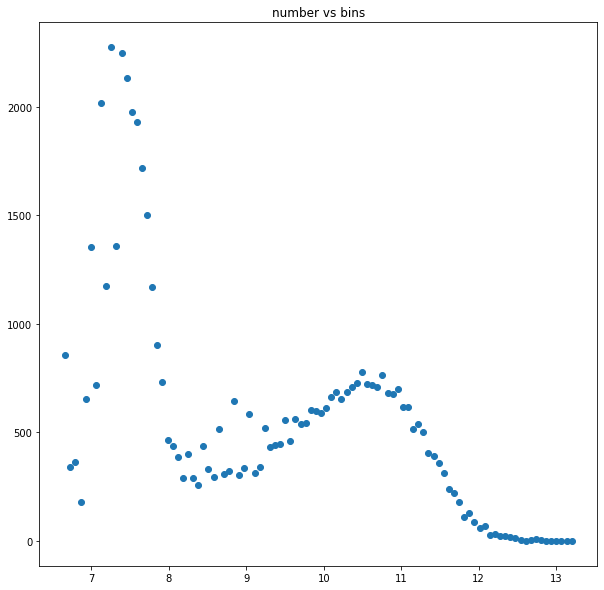

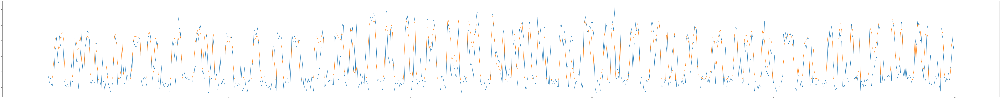

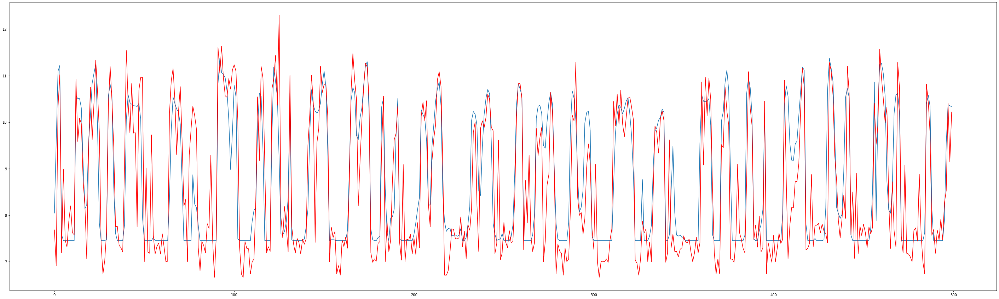

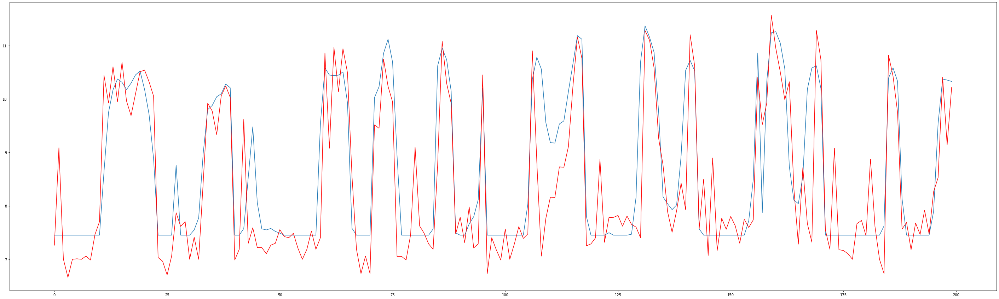

In [40]:
model.save('custom_loss_11')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.88156 median ytrue 8.318118323312142


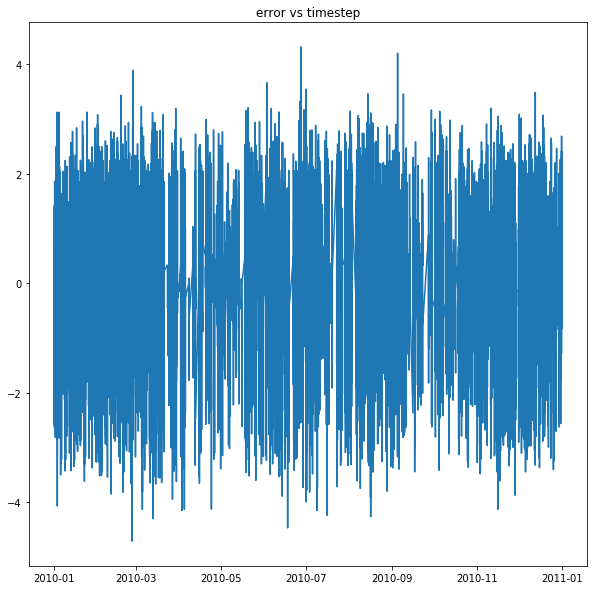

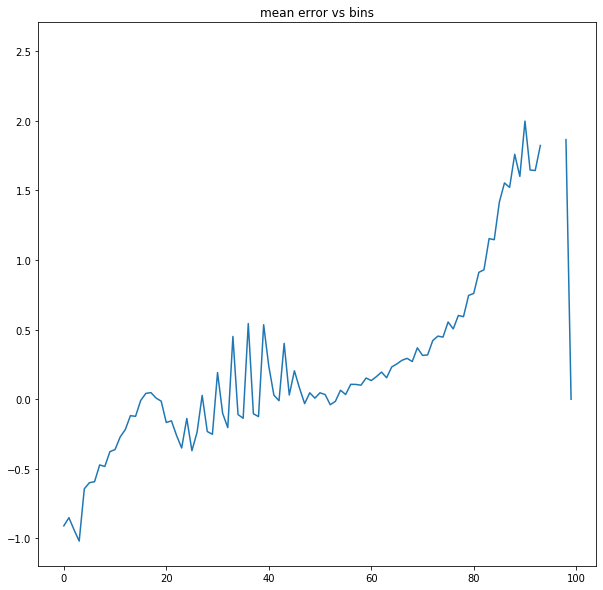

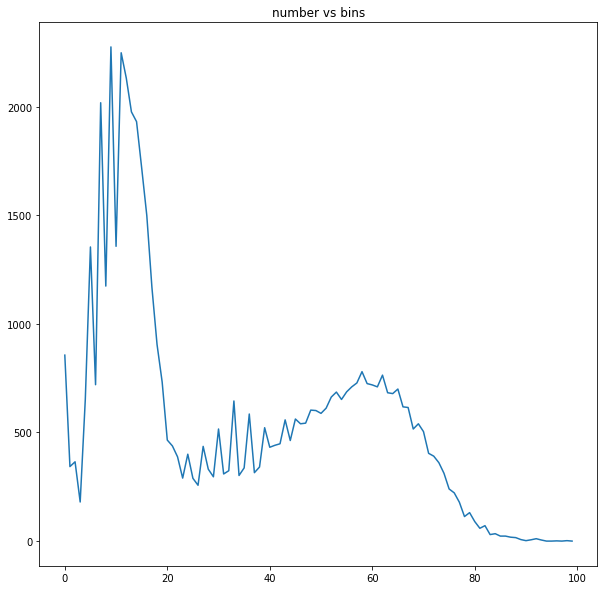

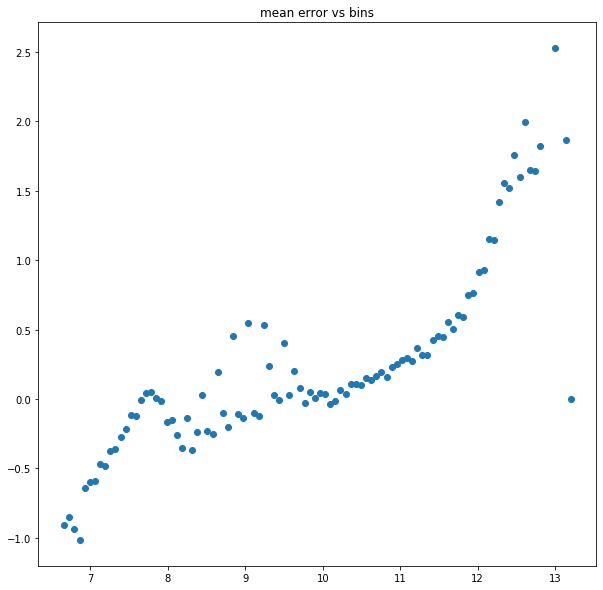

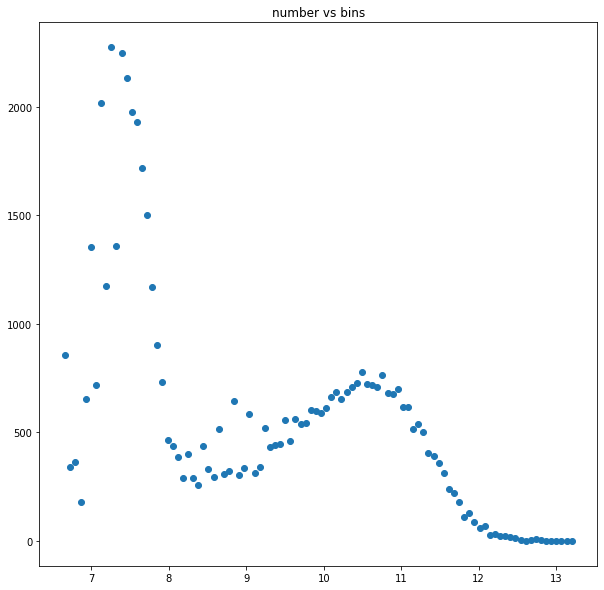

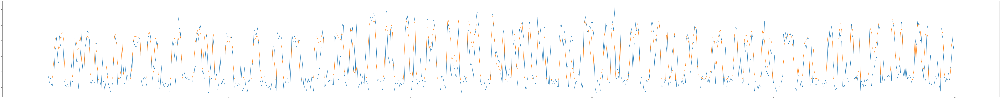

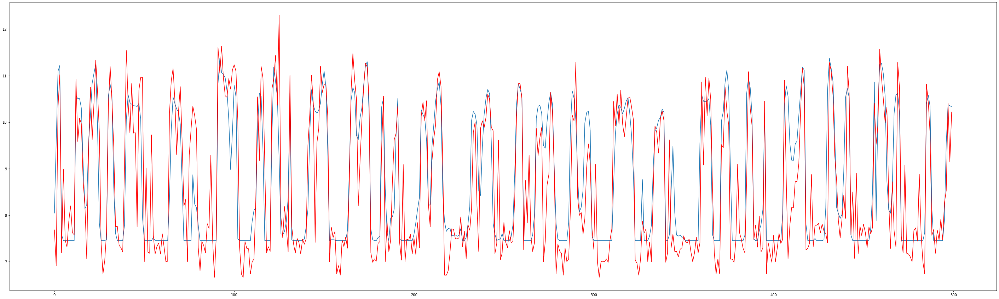

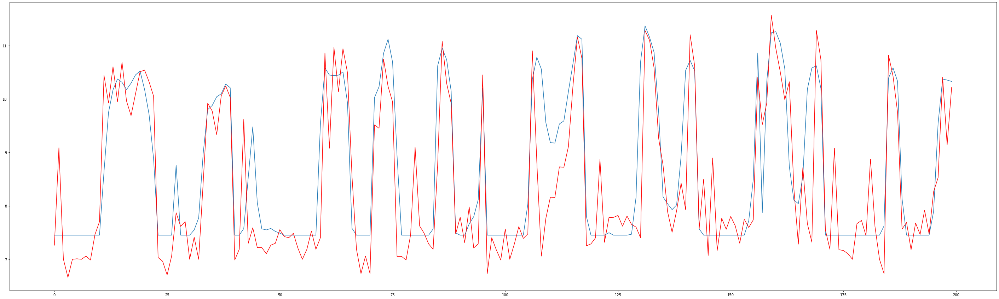

In [41]:
model.save('custom_loss_12')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()

In [42]:
from keras.models import Sequential
from keras.layers import Dense, Conv2D, Flatten
import keras.backend as K

#create model
model = Sequential()

model.add(Dense(int(148), activation='relu'))
model.add(Dense(22, activation='relu'))
model.add(Dense(4, activation='relu'))
model.add(Dense(1))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam', batch_size=8192, metrics=['mse'])

model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), epochs=200)

Train on 1838283 samples, validate on 55210 samples
Epoch 1/200
1838283/1838283 [==============================] - 52s 29us/step - loss: 2.7589 - mse: 2.7589 - val_loss: 0.7805 - val_mse: 0.7805
Epoch 2/200
1838283/1838283 [==============================] - 55s 30us/step - loss: 0.5666 - mse: 0.5666 - val_loss: 0.6843 - val_mse: 0.6843
Epoch 3/200
1838283/1838283 [==============================] - 54s 29us/step - loss: 0.5234 - mse: 0.5234 - val_loss: 0.6587 - val_mse: 0.6587
Epoch 4/200
1838283/1838283 [==============================] - 52s 28us/step - loss: 0.4694 - mse: 0.4694 - val_loss: 0.6401 - val_mse: 0.6401
Epoch 5/200
1838283/1838283 [==============================] - 52s 28us/step - loss: 0.4506 - mse: 0.4506 - val_loss: 0.6243 - val_mse: 0.6243
Epoch 6/200
1838283/1838283 [==============================] - 52s 28us/step - loss: 0.4451 - mse: 0.4451 - val_loss: 0.6375 - val_mse: 0.6375
Epoch 7/200
1838283/1838283 [==============================] - 52s 29us/step - loss: 0.440

1838283/1838283 [==============================] - 47s 25us/step - loss: 0.4063 - mse: 0.4063 - val_loss: 0.6024 - val_mse: 0.6024
Epoch 58/200
1838283/1838283 [==============================] - 47s 26us/step - loss: 0.4108 - mse: 0.4108 - val_loss: 0.6088 - val_mse: 0.6088
Epoch 59/200
1838283/1838283 [==============================] - 47s 25us/step - loss: 0.4059 - mse: 0.4059 - val_loss: 0.5947 - val_mse: 0.5947
Epoch 60/200
1838283/1838283 [==============================] - 47s 26us/step - loss: 0.4072 - mse: 0.4072 - val_loss: 0.5955 - val_mse: 0.5955
Epoch 61/200
1838283/1838283 [==============================] - 47s 26us/step - loss: 0.4055 - mse: 0.4055 - val_loss: 0.5963 - val_mse: 0.5963
Epoch 62/200
1838283/1838283 [==============================] - 47s 26us/step - loss: 0.4055 - mse: 0.4055 - val_loss: 0.5992 - val_mse: 0.5992
Epoch 63/200
1838283/1838283 [==============================] - 47s 26us/step - loss: 0.4063 - mse: 0.4063 - val_loss: 0.5979 - val_mse: 0.5979
Epoch

1838283/1838283 [==============================] - 46s 25us/step - loss: 0.4011 - mse: 0.4011 - val_loss: 0.6084 - val_mse: 0.6084
Epoch 114/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.4045 - mse: 0.4045 - val_loss: 0.5997 - val_mse: 0.5997
Epoch 115/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.4042 - mse: 0.4042 - val_loss: 0.6060 - val_mse: 0.6060
Epoch 116/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.4004 - mse: 0.4004 - val_loss: 0.6008 - val_mse: 0.6008
Epoch 117/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.4004 - mse: 0.4004 - val_loss: 0.6138 - val_mse: 0.6138
Epoch 118/200
1838283/1838283 [==============================] - 47s 25us/step - loss: 0.4003 - mse: 0.4003 - val_loss: 0.6040 - val_mse: 0.6040
Epoch 119/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.4001 - mse: 0.4001 - val_loss: 0.6094 - val_mse: 0.6094

1838283/1838283 [==============================] - 47s 25us/step - loss: 0.3976 - mse: 0.3976 - val_loss: 0.5953 - val_mse: 0.5953
Epoch 170/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.3977 - mse: 0.3977 - val_loss: 0.6022 - val_mse: 0.6022
Epoch 171/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.3989 - mse: 0.3989 - val_loss: 0.6077 - val_mse: 0.6077
Epoch 172/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.3972 - mse: 0.3972 - val_loss: 0.6018 - val_mse: 0.6018se: 0.3
Epoch 173/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.3973 - mse: 0.3973 - val_loss: 0.6047 - val_mse: 0.6047
Epoch 174/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.3973 - mse: 0.3973 - val_loss: 0.6090 - val_mse: 0.6090
Epoch 175/200
1838283/1838283 [==============================] - 46s 25us/step - loss: 0.3973 - mse: 0.3973 - val_loss: 0.5991 - val_mse:

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in double_scalars
  del sys.path[0]


min 6.662468079507718 max high 13.201022212839035 mean true 8.820067881395785 mean pred 8.7615385 median ytrue 8.318118323312142


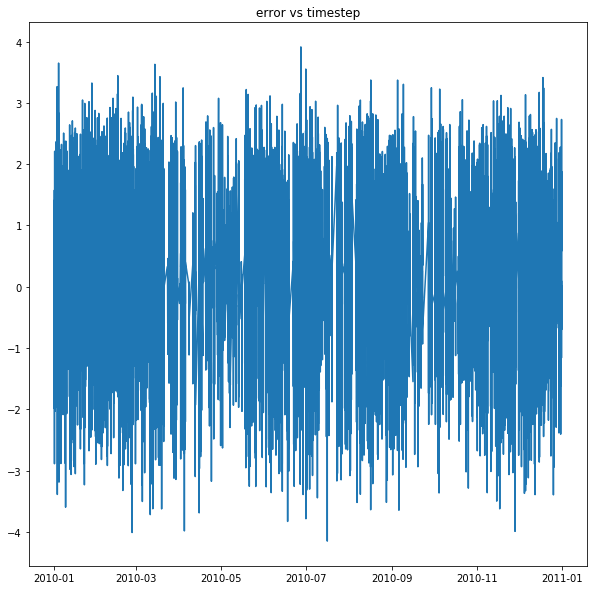

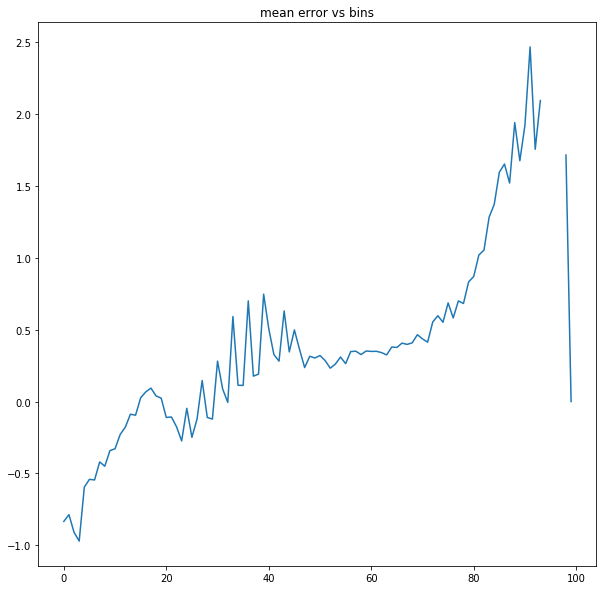

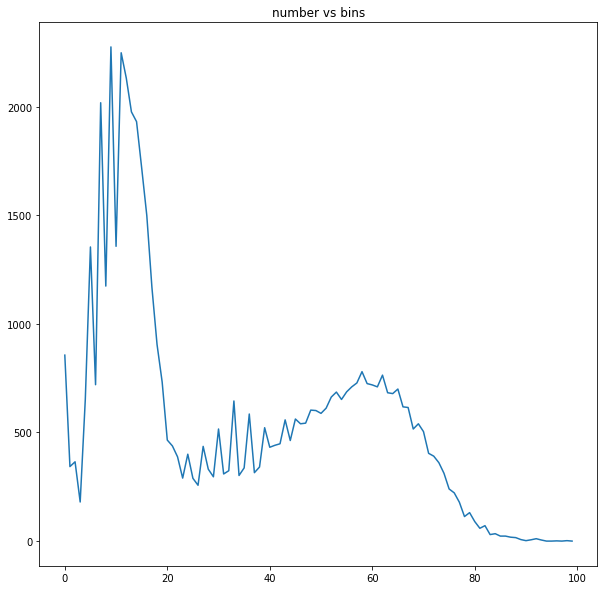

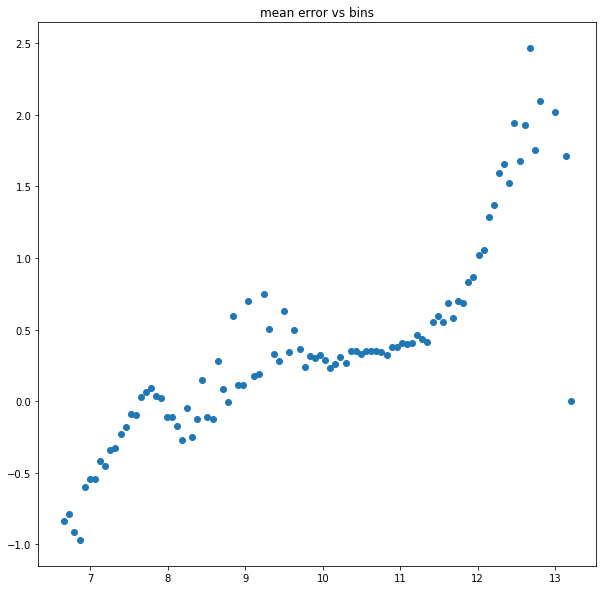

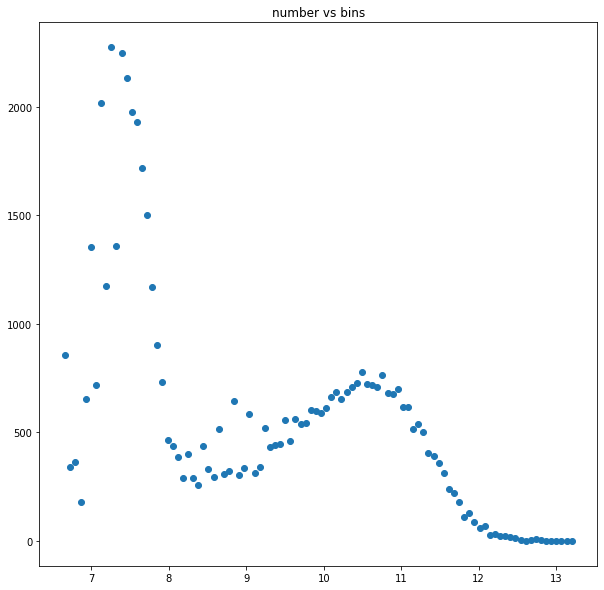

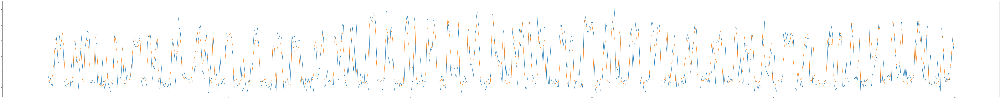

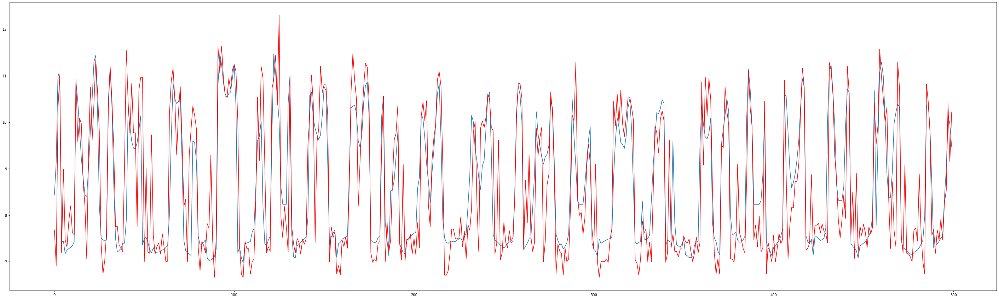

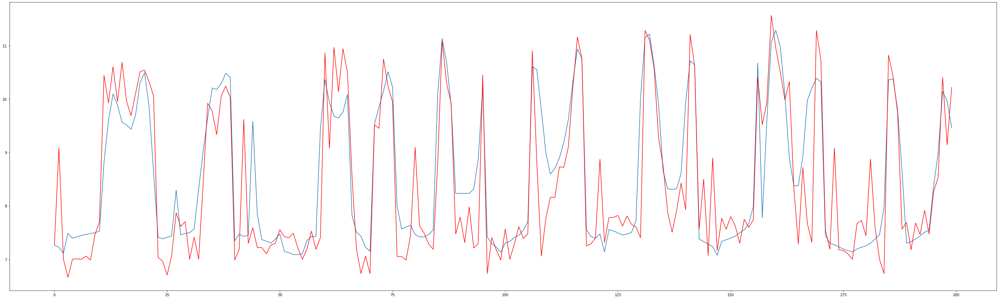

In [43]:
model.save('custom_loss_13')

y_pred = model.predict(X_test[:,:])#, y_val_log.values)#, batch_size=128)

bins, mean_error_and_num=mean_errors_over_range(y_val_log, y_pred[:,0],100)


plt.figure(figsize=(200,20))

plt.plot(y_val_log[0:1000].values)
plt.plot(y_pred[0:1000,0])
plt.show()
plt.figure(figsize=(50,15))

plt.plot(y_pred[500:1000,0])
plt.plot(y_val_log[500:1000].values,'r')
plt.show
plt.figure(figsize=(50,15))

plt.plot(y_pred[800:1000,0])
plt.plot(y_val_log[800:1000].values,'r')
plt.show()